In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

With W&B

In [ ]:
import os
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
from PIL import Image
import optuna
import time
from tqdm import tqdm
import seaborn as sns
import wandb  # New import

# Define paths and device
PAINTINGS_PATH = "/kaggle/input/wikiart/"
CSV_PATH = "/kaggle/input/labelss/filtered_class.csv"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set random seed for reproducibility
SEED = 42
torch.manual_seed(SEED)
np.random.seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)

# Custom dataset class
class WikiArtDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None, subset='train'):
        self.data_frame = pd.read_csv(csv_file)
        self.data_frame = self.data_frame[self.data_frame['subset'] == subset].reset_index(drop=True)
        self.root_dir = root_dir
        self.transform = transform
        self.data_frame['is_van_gogh'] = self.data_frame['artist'].apply(
            lambda x: 1 if 'van gogh' in x.lower() else 0
        )
        valid_rows = []
        print(f"Checking for valid images in {subset} set...")
        total_images = len(self.data_frame)
        valid_count = 0
        for idx, row in tqdm(self.data_frame.iterrows(), total=total_images):
            img_path = os.path.join(self.root_dir, row['filename'])
            if os.path.exists(img_path):
                valid_rows.append(row)
                valid_count += 1
        self.valid_data = pd.DataFrame(valid_rows) if valid_rows else pd.DataFrame(columns=self.data_frame.columns)
        print(f"Found {valid_count} valid images out of {total_images} in {subset} set")

    def __len__(self):
        return len(self.valid_data)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        img_name = self.valid_data.iloc[idx]['filename']
        img_path = os.path.join(self.root_dir, img_name)
        try:
            image = Image.open(img_path).convert('RGB')
            if self.transform:
                image = self.transform(image)
            label = self.valid_data.iloc[idx]['is_van_gogh']
            return image, label
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            if self.transform:
                return torch.zeros(3, 224, 224), 0
            else:
                return None, 0

def get_transforms(augmentation=True):
    val_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    if augmentation:
        train_transform = transforms.Compose([
            transforms.RandomResizedCrop(224),
            transforms.RandomHorizontalFlip(),
            transforms.RandomVerticalFlip(p=0.2),
            transforms.RandomRotation(15),
            transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        return train_transform, val_transform
    else:
        return val_transform, val_transform

class FineTunedModel(nn.Module):
    def __init__(self, base_model='vgg19', pretrained=True):
        super(FineTunedModel, self).__init__()
        if base_model == 'vgg19':
            self.base_model = models.vgg19(pretrained=pretrained)
            num_features = self.base_model.classifier[6].in_features
            self.base_model.classifier[6] = nn.Linear(num_features, 1)
        elif base_model == 'alexnet':
            self.base_model = models.alexnet(pretrained=pretrained)
            num_features = self.base_model.classifier[6].in_features
            self.base_model.classifier[6] = nn.Linear(num_features, 1)
        else:
            raise ValueError(f"Unsupported base model: {base_model}")

    def forward(self, x):
        x = self.base_model(x)
        return x

def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, model_name, num_epochs=10):
    best_val_auc = 0.0
    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_f1': [], 'val_f1': [],
        'train_auc': [], 'val_auc': []
    }
    for epoch in range(num_epochs):
        start_time = time.time()
        model.train()
        train_loss = 0.0
        train_preds = []
        train_labels = []
        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]"):
            inputs = inputs.to(DEVICE)
            labels = labels.float().to(DEVICE).view(-1, 1)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * inputs.size(0)
            train_preds.extend(torch.sigmoid(outputs).cpu().detach().numpy())
            train_labels.extend(labels.cpu().numpy())
        train_loss = train_loss / len(train_loader.dataset)
        train_preds = np.array(train_preds).flatten()
        train_labels = np.array(train_labels).flatten()
        train_pred_classes = (train_preds >= 0.5).astype(int)
        train_acc = accuracy_score(train_labels, train_pred_classes)
        
        if len(np.unique(train_labels)) > 1:
            train_f1 = f1_score(train_labels, train_pred_classes)
            train_auc = roc_auc_score(train_labels, train_preds)
        else:
            train_f1 = 0.0
            train_auc = 0.5
        
        model.eval()
        val_loss = 0.0
        val_preds = []
        val_labels = []
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Val]"):
                inputs = inputs.to(DEVICE)
                labels = labels.float().to(DEVICE).view(-1, 1)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item() * inputs.size(0)
                val_preds.extend(torch.sigmoid(outputs).cpu().numpy())
                val_labels.extend(labels.cpu().numpy())
        val_loss = val_loss / len(val_loader.dataset)
        val_preds = np.array(val_preds).flatten()
        val_labels = np.array(val_labels).flatten()
        val_pred_classes = (val_preds >= 0.5).astype(int)
        val_acc = accuracy_score(val_labels, val_pred_classes)
        
        if len(np.unique(val_labels)) > 1:
            val_f1 = f1_score(val_labels, val_pred_classes)
            val_auc = roc_auc_score(val_labels, val_preds)
        else:
            val_f1 = 0.0
            val_auc = 0.5
        
        if scheduler:
            scheduler.step(val_loss)
        
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)
        history['train_auc'].append(train_auc)
        history['val_auc'].append(val_auc)
        epoch_time = time.time() - start_time
        
        print(f"Epoch {epoch+1}/{num_epochs} | Time: {epoch_time:.2f}s")
        print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
        print(f"Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")
        print(f"Train F1: {train_f1:.4f} | Val F1: {val_f1:.4f}")
        print(f"Train AUC: {train_auc:.4f} | Val AUC: {val_auc:.4f}")
        print("-" * 50)
        
        # Log to wandb
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": train_loss,
            "val_loss": val_loss,
            "train_acc": train_acc,
            "val_acc": val_acc,
            "train_f1": train_f1,
            "val_f1": val_f1,
            "train_auc": train_auc,
            "val_auc": val_auc
        })
        
        if val_auc > best_val_auc:
            best_val_auc = val_auc
            model_path = f"best_model_{model_name}.pth"
            torch.save(model.state_dict(), model_path)
            wandb.save(model_path)
            print(f"Saved new best model with VAL AUC: {best_val_auc:.4f}")
    return history

def perform_kfold(model_type, dataset, k=5, batch_size=16, num_epochs=10, lr=0.001):
    all_labels = [dataset[i][1] for i in range(len(dataset))]
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=SEED)
    fold_results = []
    indices = list(range(len(dataset)))
    
    for fold, (train_idx, val_idx) in enumerate(skf.split(indices, all_labels)):
        print(f"{'='*20} Fold {fold+1}/{k} {'='*20}")
        wandb.init(
            project="van-gogh-classification",
            config={
                "model": model_type,
                "fold": fold + 1,
                "k_folds": k,
                "batch_size": batch_size,
                "lr": lr,
                "epochs": num_epochs
            },
            reinit=True
        )
        train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
        val_sampler = torch.utils.data.SubsetRandomSampler(val_idx)
        train_loader = DataLoader(dataset, batch_size=batch_size, sampler=train_sampler, num_workers=4)
        val_loader = DataLoader(dataset, batch_size=batch_size, sampler=val_sampler, num_workers=4)
        
        model = FineTunedModel(base_model=model_type, pretrained=True).to(DEVICE)
        criterion = nn.BCEWithLogitsLoss()
        optimizer = optim.Adam(model.parameters(), lr=lr)
        scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3, verbose=True)
        
        history = train_model(
            model, train_loader, val_loader, criterion, optimizer, scheduler, 
            model_name=f"{model_type}_fold{fold+1}", num_epochs=num_epochs
        )
        
        best_val_auc = max(history['val_auc'])
        fold_results.append(best_val_auc)
        print(f"Fold {fold+1} best validation AUC: {best_val_auc:.4f}")
        wandb.log({"best_val_auc": best_val_auc})
        wandb.finish()
    
    avg_auc = sum(fold_results) / len(fold_results)
    print(f"Average validation AUC across {k} folds: {avg_auc:.4f}")
    return fold_results, avg_auc

def objective(trial, model_type, train_dataset, val_dataset):
    batch_size = trial.suggest_categorical('batch_size', [8, 16, 32])
    lr = trial.suggest_float('lr', 1e-5, 1e-3, log=True)
    weight_decay = trial.suggest_float('weight_decay', 1e-6, 1e-3, log=True)
    
    wandb.init(
        project="van-gogh-classification",
        config={
            "model": model_type,
            "batch_size": batch_size,
            "lr": lr,
            "weight_decay": weight_decay,
            "trial": trial.number
        },
        reinit=True
    )
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    model = FineTunedModel(base_model=model_type, pretrained=True).to(DEVICE)
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3, verbose=True)
    
    history = train_model(
        model, train_loader, val_loader, criterion, optimizer, scheduler, 
        model_name=model_type, num_epochs=5
    )
    
    if len(history['val_auc']) == 0 or max(history['val_auc']) == 0.5:
        wandb.log({"best_val_auc": 0.0})
        wandb.finish()
        return 0.0
    
    best_auc = max(history['val_auc'])
    wandb.log({"best_val_auc": best_auc})
    wandb.finish()
    return best_auc

def plot_metrics(history, model_name):
    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    axs[0, 0].plot(history['train_loss'], label='Train Loss')
    axs[0, 0].plot(history['val_loss'], label='Val Loss')
    axs[0, 0].set_title('Loss')
    axs[0, 0].set_xlabel('Epoch')
    axs[0, 0].set_ylabel('Loss')
    axs[0, 0].legend()
    
    axs[0, 1].plot(history['train_acc'], label='Train Accuracy')
    axs[0, 1].plot(history['val_acc'], label='Val Accuracy')
    axs[0, 1].set_title('Accuracy')
    axs[0, 1].set_xlabel('Epoch')
    axs[0, 1].set_ylabel('Accuracy')
    axs[0, 1].legend()
    
    axs[1, 0].plot(history['train_f1'], label='Train F1 Score')
    axs[1, 0].plot(history['val_f1'], label='Val F1 Score')
    axs[1, 0].set_title('F1 Score')
    axs[1, 0].set_xlabel('Epoch')
    axs[1, 0].set_ylabel('F1 Score')
    axs[1, 0].legend()
    
    axs[1, 1].plot(history['train_auc'], label='Train AUC-ROC')
    axs[1, 1].plot(history['val_auc'], label='Val AUC-ROC')
    axs[1, 1].set_title('AUC-ROC')
    axs[1, 1].set_xlabel('Epoch')
    axs[1, 1].set_ylabel('AUC-ROC')
    axs[1, 1].legend()
    
    plt.tight_layout()
    plt.savefig(f"{model_name}_metrics.png")
    plt.show()

def plot_confusion_matrix(model, test_loader, model_name):
    model.eval()
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc="Generating predictions"):
            inputs = inputs.to(DEVICE)
            outputs = model(inputs)
            preds = (torch.sigmoid(outputs) >= 0.5).cpu().numpy()
            all_preds.extend(preds.flatten())
            all_labels.extend(labels.numpy())
    
    cm = confusion_matrix(all_labels, all_preds)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Van Gogh', 'Van Gogh'],
                yticklabels=['Not Van Gogh', 'Van Gogh'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.savefig(f"{model_name}_confusion_matrix.png")
    plt.show()

def main():
    wandb.login()
    print(f"Using device: {DEVICE}")
    
    print("Loading and preparing data...")
    train_transform, val_transform = get_transforms(augmentation=True)
    train_dataset = WikiArtDataset(CSV_PATH, PAINTINGS_PATH, train_transform, subset='train')
    test_dataset = WikiArtDataset(CSV_PATH, PAINTINGS_PATH, val_transform, subset='test')
    
    if len(train_dataset) == 0 or len(test_dataset) == 0:
        raise ValueError("One of the datasets is empty. Check paths and CSV file.")
    
    train_labels = [train_dataset[i][1] for i in range(len(train_dataset))]
    test_labels = [test_dataset[i][1] for i in range(len(test_dataset))]
    print(f"Train set class distribution: Van Gogh = {sum(train_labels)}, Not Van Gogh = {len(train_labels) - sum(train_labels)}")
    print(f"Test set class distribution: Van Gogh = {sum(test_labels)}, Not Van Gogh = {len(test_labels) - sum(test_labels)}")
    
    test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=4)
    
    print("\nStarting hyperparameter tuning with Optuna...")
    vgg_study = optuna.create_study(direction='maximize')
    vgg_study.optimize(lambda trial: objective(trial, 'vgg19', train_dataset, test_dataset), n_trials=5)
    print(f"Best VGG19 hyperparameters: {vgg_study.best_params}")
    
    alexnet_study = optuna.create_study(direction='maximize')
    alexnet_study.optimize(lambda trial: objective(trial, 'alexnet', train_dataset, test_dataset), n_trials=5)
    print(f"Best AlexNet hyperparameters: {alexnet_study.best_params}")
    
    print("\nPerforming K-fold cross-validation...")
    print("VGG19 K-fold cross-validation:")
    vgg_fold_results, vgg_avg_auc = perform_kfold(
        'vgg19', train_dataset, k=5, 
        batch_size=vgg_study.best_params['batch_size'], 
        lr=vgg_study.best_params['lr']
    )
    
    print("AlexNet K-fold cross-validation:")
    alexnet_fold_results, alexnet_avg_auc = perform_kfold(
        'alexnet', train_dataset, k=5, 
        batch_size=alexnet_study.best_params['batch_size'], 
        lr=alexnet_study.best_params['lr']
    )
    
    print("\nFinal training and evaluation...")
    # VGG19 final training
    wandb.init(
        project="van-gogh-classification",
        config={
            "model": "VGG19",
            "batch_size": vgg_study.best_params['batch_size'],
            "lr": vgg_study.best_params['lr'],
            "weight_decay": vgg_study.best_params['weight_decay'],
            "epochs": 15
        }
    )
    vgg19_model = FineTunedModel('vgg19').to(DEVICE)
    vgg_optimizer = optim.Adam(vgg19_model.parameters(), 
                              lr=vgg_study.best_params['lr'], 
                              weight_decay=vgg_study.best_params['weight_decay'])
    vgg_scheduler = optim.lr_scheduler.ReduceLROnPlateau(vgg_optimizer, mode='min', factor=0.1, patience=3)
    train_loader = DataLoader(train_dataset, batch_size=vgg_study.best_params['batch_size'], shuffle=True, num_workers=4)
    vgg_history = train_model(vgg19_model, train_loader, test_loader, nn.BCEWithLogitsLoss(), 
                            vgg_optimizer, vgg_scheduler, "vgg19", num_epochs=15)
    wandb.finish()
    
    # AlexNet final training
    wandb.init(
        project="van-gogh-classification",
        config={
            "model": "AlexNet",
            "batch_size": alexnet_study.best_params['batch_size'],
            "lr": alexnet_study.best_params['lr'],
            "weight_decay": alexnet_study.best_params['weight_decay'],
            "epochs": 15
        }
    )
    alexnet_model = FineTunedModel('alexnet').to(DEVICE)
    alex_optimizer = optim.Adam(alexnet_model.parameters(), 
                               lr=alexnet_study.best_params['lr'], 
                               weight_decay=alexnet_study.best_params['weight_decay'])
    alex_scheduler = optim.lr_scheduler.ReduceLROnPlateau(alex_optimizer, mode='min', factor=0.1, patience=3)
    train_loader = DataLoader(train_dataset, batch_size=alexnet_study.best_params['batch_size'], shuffle=True, num_workers=4)
    alex_history = train_model(alexnet_model, train_loader, test_loader, nn.BCEWithLogitsLoss(), 
                             alex_optimizer, alex_scheduler, "alexnet", num_epochs=15)
    wandb.finish()
    
    plot_metrics(vgg_history, "VGG19")
    plot_metrics(alex_history, "AlexNet")
    plot_confusion_matrix(vgg19_model, test_loader, "VGG19")
    plot_confusion_matrix(alexnet_model, test_loader, "AlexNet")
    
    print("\nModel Performance Comparison:")
    print(f"VGG19 Best Validation AUC: {max(vgg_history['val_auc']):.4f}")
    print(f"AlexNet Best Validation AUC: {max(alex_history['val_auc']):.4f}")
    print("VGG19" if max(vgg_history['val_auc']) > max(alex_history['val_auc']) else "AlexNet", 
          "performs better in detecting Van Gogh paintings!")
    print("\nTraining completed successfully!")

if __name__ == "__main__":
    main()

Using device: cuda
Loading and preparing data...
Checking for valid images in train set...


100%|██████████| 5029/5029 [00:02<00:00, 1744.36it/s]


Found 5022 valid images out of 5029 in train set
Checking for valid images in test set...


100%|██████████| 1245/1245 [00:00<00:00, 3410.84it/s]


Found 1243 valid images out of 1245 in test set


[I 2025-03-23 11:08:01,069] A new study created in memory with name: no-name-1288fde0-e5d6-4686-ad82-4e3bf1c4238f


Train set class distribution: Van Gogh = 806, Not Van Gogh = 4216
Test set class distribution: Van Gogh = 197, Not Van Gogh = 1046

Starting hyperparameter tuning with Optuna...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.42it/s]


Epoch 1/5 | Time: 113.74s
Train Loss: 0.4989 | Val Loss: 0.4791
Train Acc: 0.8385 | Val Acc: 0.8415
Train F1: 0.0073 | Val F1: 0.0000
Train AUC: 0.5350 | Val AUC: 0.5000
--------------------------------------------------
Saved new best model with VAL AUC: 0.5000


Epoch 2/5 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.49it/s]


Epoch 2/5 | Time: 113.26s
Train Loss: 0.4455 | Val Loss: 0.4372
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5025 | Val AUC: 0.5000
--------------------------------------------------


Epoch 3/5 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.44it/s]


Epoch 3/5 | Time: 114.43s
Train Loss: 0.4435 | Val Loss: 0.4399
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5022 | Val AUC: 0.5000
--------------------------------------------------


Epoch 4/5 [Val]: 100%|██████████| 78/78 [00:18<00:00,  4.31it/s]


Epoch 4/5 | Time: 114.73s
Train Loss: 0.4436 | Val Loss: 0.4405
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5099 | Val AUC: 0.5000
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.57it/s]
[I 2025-03-23 11:17:34,524] Trial 0 finished with value: 0.0 and parameters: {'batch_size': 16, 'lr': 0.0005415970463454132, 'weight_decay': 2.2739444987397806e-06}. Best is trial 0 with value: 0.0.
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 5/5 | Time: 113.81s
Train Loss: 0.4447 | Val Loss: 0.4399
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4986 | Val AUC: 0.5000
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 156/156 [00:18<00:00,  8.66it/s]


Epoch 1/5 | Time: 161.56s
Train Loss: 0.2746 | Val Loss: 0.2109
Train Acc: 0.8861 | Val Acc: 0.9372
Train F1: 0.5712 | Val F1: 0.7636
Train AUC: 0.8978 | Val AUC: 0.9616
--------------------------------------------------
Saved new best model with VAL AUC: 0.9616


Epoch 2/5 [Val]: 100%|██████████| 156/156 [00:17<00:00,  8.69it/s]


Epoch 2/5 | Time: 161.79s
Train Loss: 0.2184 | Val Loss: 0.1535
Train Acc: 0.9110 | Val Acc: 0.9437
Train F1: 0.6986 | Val F1: 0.8077
Train AUC: 0.9374 | Val AUC: 0.9713
--------------------------------------------------
Saved new best model with VAL AUC: 0.9713


Epoch 3/5 [Val]: 100%|██████████| 156/156 [00:17<00:00,  8.71it/s]


Epoch 3/5 | Time: 161.82s
Train Loss: 0.1951 | Val Loss: 0.1442
Train Acc: 0.9215 | Val Acc: 0.9477
Train F1: 0.7391 | Val F1: 0.8267
Train AUC: 0.9499 | Val AUC: 0.9728
--------------------------------------------------
Saved new best model with VAL AUC: 0.9728


Epoch 4/5 [Val]: 100%|██████████| 156/156 [00:18<00:00,  8.45it/s]


Epoch 4/5 | Time: 162.61s
Train Loss: 0.1691 | Val Loss: 0.1379
Train Acc: 0.9305 | Val Acc: 0.9549
Train F1: 0.7720 | Val F1: 0.8542
Train AUC: 0.9641 | Val AUC: 0.9739
--------------------------------------------------
Saved new best model with VAL AUC: 0.9739


Epoch 5/5 [Val]: 100%|██████████| 156/156 [00:18<00:00,  8.49it/s]
[I 2025-03-23 11:31:12,840] Trial 1 finished with value: 0.9739447350797332 and parameters: {'batch_size': 8, 'lr': 1.5179244163670776e-05, 'weight_decay': 4.937215032515316e-05}. Best is trial 1 with value: 0.9739447350797332.
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 5/5 | Time: 162.14s
Train Loss: 0.1748 | Val Loss: 0.1403
Train Acc: 0.9325 | Val Acc: 0.9461
Train F1: 0.7797 | Val F1: 0.8164
Train AUC: 0.9604 | Val AUC: 0.9719
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 39/39 [00:17<00:00,  2.19it/s]


Epoch 1/5 | Time: 111.41s
Train Loss: 0.3620 | Val Loss: 0.2359
Train Acc: 0.8554 | Val Acc: 0.8922
Train F1: 0.3847 | Val F1: 0.4924
Train AUC: 0.7990 | Val AUC: 0.9588
--------------------------------------------------
Saved new best model with VAL AUC: 0.9588


Epoch 2/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.15it/s]


Epoch 2/5 | Time: 111.20s
Train Loss: 0.2921 | Val Loss: 0.2480
Train Acc: 0.8817 | Val Acc: 0.8962
Train F1: 0.5835 | Val F1: 0.7296
Train AUC: 0.8801 | Val AUC: 0.9525
--------------------------------------------------


Epoch 3/5 [Val]: 100%|██████████| 39/39 [00:17<00:00,  2.17it/s]


Epoch 3/5 | Time: 110.85s
Train Loss: 0.2495 | Val Loss: 0.3007
Train Acc: 0.9010 | Val Acc: 0.8866
Train F1: 0.6612 | Val F1: 0.4427
Train AUC: 0.9171 | Val AUC: 0.9451
--------------------------------------------------


Epoch 4/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.12it/s]


Epoch 4/5 | Time: 111.03s
Train Loss: 0.2542 | Val Loss: 0.1748
Train Acc: 0.8961 | Val Acc: 0.9356
Train F1: 0.6360 | Val F1: 0.7765
Train AUC: 0.9120 | Val AUC: 0.9584
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 39/39 [00:17<00:00,  2.19it/s]


Epoch 5/5 | Time: 110.69s
Train Loss: 0.2234 | Val Loss: 0.1647
Train Acc: 0.9114 | Val Acc: 0.9405
Train F1: 0.6925 | Val F1: 0.7989
Train AUC: 0.9347 | Val AUC: 0.9643
--------------------------------------------------


[I 2025-03-23 11:40:33,233] Trial 2 finished with value: 0.964311712009007 and parameters: {'batch_size': 32, 'lr': 0.00015149715376683596, 'weight_decay': 5.3427366383309246e-05}. Best is trial 1 with value: 0.9739447350797332.


Saved new best model with VAL AUC: 0.9643


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.12it/s]


Epoch 1/5 | Time: 109.24s
Train Loss: 0.4519 | Val Loss: 0.2947
Train Acc: 0.8361 | Val Acc: 0.8415
Train F1: 0.0784 | Val F1: 0.0000
Train AUC: 0.5945 | Val AUC: 0.9199
--------------------------------------------------
Saved new best model with VAL AUC: 0.9199


Epoch 2/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.15it/s]


Epoch 2/5 | Time: 109.20s
Train Loss: 0.3485 | Val Loss: 0.2745
Train Acc: 0.8491 | Val Acc: 0.8785
Train F1: 0.2903 | Val F1: 0.4032
Train AUC: 0.8192 | Val AUC: 0.9367
--------------------------------------------------
Saved new best model with VAL AUC: 0.9367


Epoch 3/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.17it/s]


Epoch 3/5 | Time: 109.05s
Train Loss: 0.3054 | Val Loss: 0.2138
Train Acc: 0.8730 | Val Acc: 0.9284
Train F1: 0.5092 | Val F1: 0.7479
Train AUC: 0.8676 | Val AUC: 0.9461
--------------------------------------------------
Saved new best model with VAL AUC: 0.9461


Epoch 4/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.15it/s]


Epoch 4/5 | Time: 110.31s
Train Loss: 0.3063 | Val Loss: 0.2366
Train Acc: 0.8714 | Val Acc: 0.8994
Train F1: 0.4921 | Val F1: 0.5704
Train AUC: 0.8681 | Val AUC: 0.9486
--------------------------------------------------
Saved new best model with VAL AUC: 0.9486


Epoch 5/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.15it/s]


Epoch 5/5 | Time: 113.02s
Train Loss: 0.2972 | Val Loss: 0.2286
Train Acc: 0.8720 | Val Acc: 0.9268
Train F1: 0.5162 | Val F1: 0.7451
Train AUC: 0.8774 | Val AUC: 0.9534
--------------------------------------------------


[I 2025-03-23 11:49:54,140] Trial 3 finished with value: 0.95336355077598 and parameters: {'batch_size': 32, 'lr': 0.0002948636314863073, 'weight_decay': 2.168285979346139e-05}. Best is trial 1 with value: 0.9739447350797332.


Saved new best model with VAL AUC: 0.9534


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 39/39 [00:17<00:00,  2.21it/s]


Epoch 1/5 | Time: 112.54s
Train Loss: 0.4973 | Val Loss: 0.2852
Train Acc: 0.8383 | Val Acc: 0.8874
Train F1: 0.0240 | Val F1: 0.5238
Train AUC: 0.5985 | Val AUC: 0.8854
--------------------------------------------------
Saved new best model with VAL AUC: 0.8854


Epoch 2/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.15it/s]


Epoch 2/5 | Time: 112.94s
Train Loss: 0.3856 | Val Loss: 0.2437
Train Acc: 0.8449 | Val Acc: 0.9099
Train F1: 0.3302 | Val F1: 0.6725
Train AUC: 0.7550 | Val AUC: 0.9272
--------------------------------------------------
Saved new best model with VAL AUC: 0.9272


Epoch 3/5 [Val]: 100%|██████████| 39/39 [00:17<00:00,  2.22it/s]


Epoch 3/5 | Time: 112.91s
Train Loss: 0.3314 | Val Loss: 0.2497
Train Acc: 0.8638 | Val Acc: 0.8970
Train F1: 0.4537 | Val F1: 0.5556
Train AUC: 0.8305 | Val AUC: 0.9431
--------------------------------------------------
Saved new best model with VAL AUC: 0.9431


Epoch 4/5 [Val]: 100%|██████████| 39/39 [00:18<00:00,  2.14it/s]


Epoch 4/5 | Time: 113.33s
Train Loss: 0.3087 | Val Loss: 0.2473
Train Acc: 0.8736 | Val Acc: 0.8938
Train F1: 0.5149 | Val F1: 0.7027
Train AUC: 0.8627 | Val AUC: 0.9386
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 39/39 [00:17<00:00,  2.23it/s]


Epoch 5/5 | Time: 112.60s
Train Loss: 0.3234 | Val Loss: 0.2166
Train Acc: 0.8688 | Val Acc: 0.9292
Train F1: 0.5026 | Val F1: 0.7412
Train AUC: 0.8383 | Val AUC: 0.9474
--------------------------------------------------


[I 2025-03-23 11:59:26,825] Trial 4 finished with value: 0.9473799147829295 and parameters: {'batch_size': 32, 'lr': 0.0005803315574282635, 'weight_decay': 0.0005768957495916074}. Best is trial 1 with value: 0.9739447350797332.
[I 2025-03-23 11:59:26,826] A new study created in memory with name: no-name-eea55f9e-7f0e-4569-80e5-bb1b42ec3a10


Saved new best model with VAL AUC: 0.9474
Best VGG19 hyperparameters: {'batch_size': 8, 'lr': 1.5179244163670776e-05, 'weight_decay': 4.937215032515316e-05}
Best VGG19 validation AUC: 0.9739


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 212MB/s]  
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.w

Epoch 1/5 | Time: 79.63s
Train Loss: 0.4702 | Val Loss: 0.4399
Train Acc: 0.8355 | Val Acc: 0.8415
Train F1: 0.0167 | Val F1: 0.0000
Train AUC: 0.5199 | Val AUC: 0.5000
--------------------------------------------------
Saved new best model with VAL AUC: 0.5000


Epoch 2/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.35it/s]


Epoch 2/5 | Time: 81.23s
Train Loss: 0.4434 | Val Loss: 0.4372
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5000 | Val AUC: 0.5000
--------------------------------------------------


Epoch 3/5 [Val]: 100%|██████████| 39/39 [00:15<00:00,  2.45it/s]


Epoch 3/5 | Time: 80.66s
Train Loss: 0.4431 | Val Loss: 0.4391
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5023 | Val AUC: 0.5000
--------------------------------------------------


Epoch 4/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.34it/s]


Epoch 4/5 | Time: 81.61s
Train Loss: 0.4428 | Val Loss: 0.4408
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4932 | Val AUC: 0.4990
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 39/39 [00:15<00:00,  2.44it/s]
[I 2025-03-23 12:06:12,988] Trial 0 finished with value: 0.0 and parameters: {'batch_size': 32, 'lr': 0.0007616879018593278, 'weight_decay': 2.9423753060922495e-05}. Best is trial 0 with value: 0.0.
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 5/5 | Time: 80.49s
Train Loss: 0.4444 | Val Loss: 0.4378
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4755 | Val AUC: 0.5000
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.83it/s]


Epoch 1/5 | Time: 82.84s
Train Loss: 0.4725 | Val Loss: 0.4416
Train Acc: 0.8369 | Val Acc: 0.8415
Train F1: 0.0024 | Val F1: 0.0000
Train AUC: 0.4960 | Val AUC: 0.5005
--------------------------------------------------
Saved new best model with VAL AUC: 0.5005


Epoch 2/5 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.99it/s]


Epoch 2/5 | Time: 79.80s
Train Loss: 0.4455 | Val Loss: 0.4396
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4930 | Val AUC: 0.5000
--------------------------------------------------


Epoch 3/5 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.78it/s]


Epoch 3/5 | Time: 80.54s
Train Loss: 0.4442 | Val Loss: 0.4372
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5004 | Val AUC: 0.5016
--------------------------------------------------
Saved new best model with VAL AUC: 0.5016


Epoch 4/5 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.89it/s]


Epoch 4/5 | Time: 80.33s
Train Loss: 0.4463 | Val Loss: 0.4375
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4822 | Val AUC: 0.4986
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.74it/s]
[I 2025-03-23 12:12:59,386] Trial 1 finished with value: 0.5015820481214391 and parameters: {'batch_size': 16, 'lr': 0.0008122212156922016, 'weight_decay': 2.4694256114422318e-05}. Best is trial 1 with value: 0.5015820481214391.
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 5/5 | Time: 80.63s
Train Loss: 0.6194 | Val Loss: 0.5641
Train Acc: 0.8321 | Val Acc: 0.8415
Train F1: 0.0388 | Val F1: 0.0000
Train AUC: 0.4972 | Val AUC: 0.4042
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.40it/s]


Epoch 1/5 | Time: 79.83s
Train Loss: 0.3074 | Val Loss: 0.2121
Train Acc: 0.8755 | Val Acc: 0.9195
Train F1: 0.5218 | Val F1: 0.6914
Train AUC: 0.8647 | Val AUC: 0.9418
--------------------------------------------------
Saved new best model with VAL AUC: 0.9418


Epoch 2/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.37it/s]


Epoch 2/5 | Time: 81.03s
Train Loss: 0.2447 | Val Loss: 0.1991
Train Acc: 0.9032 | Val Acc: 0.9268
Train F1: 0.6606 | Val F1: 0.7493
Train AUC: 0.9188 | Val AUC: 0.9560
--------------------------------------------------
Saved new best model with VAL AUC: 0.9560


Epoch 3/5 [Val]: 100%|██████████| 39/39 [00:15<00:00,  2.45it/s]


Epoch 3/5 | Time: 80.07s
Train Loss: 0.2326 | Val Loss: 0.2036
Train Acc: 0.9064 | Val Acc: 0.9252
Train F1: 0.6736 | Val F1: 0.7748
Train AUC: 0.9252 | Val AUC: 0.9566
--------------------------------------------------
Saved new best model with VAL AUC: 0.9566


Epoch 4/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.35it/s]


Epoch 4/5 | Time: 81.40s
Train Loss: 0.2168 | Val Loss: 0.2409
Train Acc: 0.9144 | Val Acc: 0.9195
Train F1: 0.7075 | Val F1: 0.7642
Train AUC: 0.9380 | Val AUC: 0.9535
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 39/39 [00:15<00:00,  2.44it/s]


Epoch 5/5 | Time: 80.15s
Train Loss: 0.2099 | Val Loss: 0.1845
Train Acc: 0.9170 | Val Acc: 0.9228
Train F1: 0.7122 | Val F1: 0.7612
Train AUC: 0.9413 | Val AUC: 0.9622
--------------------------------------------------


[I 2025-03-23 12:19:45,411] Trial 2 finished with value: 0.9621958439692908 and parameters: {'batch_size': 32, 'lr': 7.244274531734542e-05, 'weight_decay': 1.4255246775716157e-06}. Best is trial 2 with value: 0.9621958439692908.


Saved new best model with VAL AUC: 0.9622


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.36it/s]


Epoch 1/5 | Time: 80.53s
Train Loss: 0.3298 | Val Loss: 0.2274
Train Acc: 0.8604 | Val Acc: 0.9131
Train F1: 0.4153 | Val F1: 0.6707
Train AUC: 0.8345 | Val AUC: 0.9240
--------------------------------------------------
Saved new best model with VAL AUC: 0.9240


Epoch 2/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.42it/s]


Epoch 2/5 | Time: 80.64s
Train Loss: 0.2467 | Val Loss: 0.1993
Train Acc: 0.8973 | Val Acc: 0.9292
Train F1: 0.6314 | Val F1: 0.7427
Train AUC: 0.9167 | Val AUC: 0.9428
--------------------------------------------------
Saved new best model with VAL AUC: 0.9428


Epoch 3/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.38it/s]


Epoch 3/5 | Time: 80.69s
Train Loss: 0.2231 | Val Loss: 0.2128
Train Acc: 0.9056 | Val Acc: 0.9139
Train F1: 0.6749 | Val F1: 0.7482
Train AUC: 0.9337 | Val AUC: 0.9493
--------------------------------------------------
Saved new best model with VAL AUC: 0.9493


Epoch 4/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.40it/s]


Epoch 4/5 | Time: 80.67s
Train Loss: 0.2127 | Val Loss: 0.1810
Train Acc: 0.9144 | Val Acc: 0.9308
Train F1: 0.7087 | Val F1: 0.7701
Train AUC: 0.9392 | Val AUC: 0.9535
--------------------------------------------------
Saved new best model with VAL AUC: 0.9535


Epoch 5/5 [Val]: 100%|██████████| 39/39 [00:16<00:00,  2.37it/s]


Epoch 5/5 | Time: 81.36s
Train Loss: 0.1935 | Val Loss: 0.1838
Train Acc: 0.9186 | Val Acc: 0.9316
Train F1: 0.7242 | Val F1: 0.7815
Train AUC: 0.9514 | Val AUC: 0.9555
--------------------------------------------------


[I 2025-03-23 12:26:33,548] Trial 3 finished with value: 0.9554745659073482 and parameters: {'batch_size': 32, 'lr': 1.3207611719047176e-05, 'weight_decay': 4.63037451721645e-06}. Best is trial 2 with value: 0.9621958439692908.


Saved new best model with VAL AUC: 0.9555


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/5 [Val]: 100%|██████████| 156/156 [00:16<00:00,  9.70it/s]


Epoch 1/5 | Time: 81.96s
Train Loss: 0.4800 | Val Loss: 0.4376
Train Acc: 0.8377 | Val Acc: 0.8415
Train F1: 0.0193 | Val F1: 0.0000
Train AUC: 0.5370 | Val AUC: 0.5003
--------------------------------------------------
Saved new best model with VAL AUC: 0.5003


Epoch 2/5 [Val]: 100%|██████████| 156/156 [00:15<00:00,  9.87it/s]


Epoch 2/5 | Time: 81.58s
Train Loss: 0.4567 | Val Loss: 0.4390
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.5046 | Val AUC: 0.5000
--------------------------------------------------


Epoch 3/5 [Val]: 100%|██████████| 156/156 [00:16<00:00,  9.44it/s]


Epoch 3/5 | Time: 83.15s
Train Loss: 0.4449 | Val Loss: 0.4378
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4910 | Val AUC: 0.5021
--------------------------------------------------
Saved new best model with VAL AUC: 0.5021


Epoch 4/5 [Val]: 100%|██████████| 156/156 [00:16<00:00,  9.65it/s]


Epoch 4/5 | Time: 82.89s
Train Loss: 0.4442 | Val Loss: 0.4494
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4853 | Val AUC: 0.4995
--------------------------------------------------


Epoch 5/5 [Val]: 100%|██████████| 156/156 [00:16<00:00,  9.36it/s]
[I 2025-03-23 12:33:28,544] Trial 4 finished with value: 0.5020624860478884 and parameters: {'batch_size': 8, 'lr': 0.0003593975836194774, 'weight_decay': 5.743275325806425e-05}. Best is trial 2 with value: 0.9621958439692908.


Epoch 5/5 | Time: 83.20s
Train Loss: 0.4438 | Val Loss: 0.4372
Train Acc: 0.8395 | Val Acc: 0.8415
Train F1: 0.0000 | Val F1: 0.0000
Train AUC: 0.4999 | Val AUC: 0.5003
--------------------------------------------------
Best AlexNet hyperparameters: {'batch_size': 32, 'lr': 7.244274531734542e-05, 'weight_decay': 1.4255246775716157e-06}
Best AlexNet validation AUC: 0.9622

Performing K-fold cross-validation...
VGG19 K-fold cross-validation:
==================== Fold 1/5 ====================


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.71it/s]


Epoch 1/10 | Time: 121.75s
Train Loss: 0.2355 | Val Loss: 0.0431
Train Acc: 0.8758 | Val Acc: 0.9095
Train F1: 0.5141 | Val F1: 0.7016
Train AUC: 0.8787 | Val AUC: 0.9386
--------------------------------------------------
Saved new best model with VAL AUC: 0.9386


Epoch 2/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.74it/s]


Epoch 2/10 | Time: 125.06s
Train Loss: 0.1848 | Val Loss: 0.0403
Train Acc: 0.9094 | Val Acc: 0.9264
Train F1: 0.6972 | Val F1: 0.7279
Train AUC: 0.9289 | Val AUC: 0.9615
--------------------------------------------------
Saved new best model with VAL AUC: 0.9615


Epoch 3/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.75it/s]


Epoch 3/10 | Time: 126.20s
Train Loss: 0.1621 | Val Loss: 0.0375
Train Acc: 0.9206 | Val Acc: 0.9363
Train F1: 0.7392 | Val F1: 0.8012
Train AUC: 0.9483 | Val AUC: 0.9664
--------------------------------------------------
Saved new best model with VAL AUC: 0.9664


Epoch 4/10 [Val]: 100%|██████████| 126/126 [00:13<00:00,  9.02it/s]


Epoch 4/10 | Time: 126.06s
Train Loss: 0.1465 | Val Loss: 0.0387
Train Acc: 0.9261 | Val Acc: 0.9164
Train F1: 0.7572 | Val F1: 0.7627
Train AUC: 0.9571 | Val AUC: 0.9647
--------------------------------------------------


Epoch 5/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.85it/s]


Epoch 5/10 | Time: 126.53s
Train Loss: 0.1374 | Val Loss: 0.0403
Train Acc: 0.9310 | Val Acc: 0.9194
Train F1: 0.7720 | Val F1: 0.7793
Train AUC: 0.9625 | Val AUC: 0.9712
--------------------------------------------------
Saved new best model with VAL AUC: 0.9712


Epoch 6/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.92it/s]


Epoch 6/10 | Time: 128.89s
Train Loss: 0.1356 | Val Loss: 0.0336
Train Acc: 0.9343 | Val Acc: 0.9264
Train F1: 0.7881 | Val F1: 0.7716
Train AUC: 0.9635 | Val AUC: 0.9651
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.94it/s]


Epoch 7/10 | Time: 130.23s
Train Loss: 0.1310 | Val Loss: 0.0310
Train Acc: 0.9370 | Val Acc: 0.9373
Train F1: 0.7938 | Val F1: 0.8000
Train AUC: 0.9654 | Val AUC: 0.9681
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.97it/s]


Epoch 8/10 | Time: 129.92s
Train Loss: 0.1168 | Val Loss: 0.0287
Train Acc: 0.9475 | Val Acc: 0.9463
Train F1: 0.8286 | Val F1: 0.8247
Train AUC: 0.9711 | Val AUC: 0.9732
--------------------------------------------------
Saved new best model with VAL AUC: 0.9732


Epoch 9/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.54it/s]


Epoch 9/10 | Time: 131.07s
Train Loss: 0.1073 | Val Loss: 0.0263
Train Acc: 0.9472 | Val Acc: 0.9502
Train F1: 0.8304 | Val F1: 0.8322
Train AUC: 0.9761 | Val AUC: 0.9738
--------------------------------------------------
Saved new best model with VAL AUC: 0.9738


Epoch 10/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.53it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 130.89s
Train Loss: 0.1043 | Val Loss: 0.0383
Train Acc: 0.9467 | Val Acc: 0.9214
Train F1: 0.8277 | Val F1: 0.7799
Train AUC: 0.9787 | Val AUC: 0.9698
--------------------------------------------------
Fold 1 best validation AUC: 0.9738
==================== Fold 2/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.66it/s]


Epoch 1/10 | Time: 130.87s
Train Loss: 0.2381 | Val Loss: 0.0448
Train Acc: 0.8780 | Val Acc: 0.9005
Train F1: 0.5288 | Val F1: 0.5726
Train AUC: 0.8734 | Val AUC: 0.9502
--------------------------------------------------
Saved new best model with VAL AUC: 0.9502


Epoch 2/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.88it/s]


Epoch 2/10 | Time: 130.23s
Train Loss: 0.1874 | Val Loss: 0.0436
Train Acc: 0.9029 | Val Acc: 0.9353
Train F1: 0.6609 | Val F1: 0.7910
Train AUC: 0.9261 | Val AUC: 0.9583
--------------------------------------------------
Saved new best model with VAL AUC: 0.9583


Epoch 3/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.79it/s]


Epoch 3/10 | Time: 130.59s
Train Loss: 0.1600 | Val Loss: 0.0360
Train Acc: 0.9213 | Val Acc: 0.9274
Train F1: 0.7345 | Val F1: 0.7384
Train AUC: 0.9471 | Val AUC: 0.9609
--------------------------------------------------
Saved new best model with VAL AUC: 0.9609


Epoch 4/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.74it/s]


Epoch 4/10 | Time: 127.92s
Train Loss: 0.1541 | Val Loss: 0.0354
Train Acc: 0.9221 | Val Acc: 0.9373
Train F1: 0.7385 | Val F1: 0.7907
Train AUC: 0.9533 | Val AUC: 0.9646
--------------------------------------------------
Saved new best model with VAL AUC: 0.9646


Epoch 5/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.81it/s]


Epoch 5/10 | Time: 126.90s
Train Loss: 0.1416 | Val Loss: 0.0499
Train Acc: 0.9286 | Val Acc: 0.8995
Train F1: 0.7642 | Val F1: 0.7469
Train AUC: 0.9593 | Val AUC: 0.9696
--------------------------------------------------
Saved new best model with VAL AUC: 0.9696


Epoch 6/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.75it/s]


Epoch 6/10 | Time: 126.93s
Train Loss: 0.1353 | Val Loss: 0.0316
Train Acc: 0.9258 | Val Acc: 0.9473
Train F1: 0.7529 | Val F1: 0.8349
Train AUC: 0.9638 | Val AUC: 0.9673
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.69it/s]


Epoch 7/10 | Time: 126.97s
Train Loss: 0.1250 | Val Loss: 0.0360
Train Acc: 0.9380 | Val Acc: 0.9323
Train F1: 0.7977 | Val F1: 0.7671
Train AUC: 0.9683 | Val AUC: 0.9650
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.74it/s]


Epoch 8/10 | Time: 126.87s
Train Loss: 0.1245 | Val Loss: 0.0339
Train Acc: 0.9353 | Val Acc: 0.9383
Train F1: 0.7893 | Val F1: 0.7961
Train AUC: 0.9697 | Val AUC: 0.9644
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.80it/s]


Epoch 9/10 | Time: 126.80s
Train Loss: 0.1089 | Val Loss: 0.0436
Train Acc: 0.9470 | Val Acc: 0.9134
Train F1: 0.8286 | Val F1: 0.6360
Train AUC: 0.9766 | Val AUC: 0.9662
--------------------------------------------------


Epoch 10/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.87it/s]


Epoch 10/10 | Time: 126.67s
Train Loss: 0.1073 | Val Loss: 0.0372
Train Acc: 0.9455 | Val Acc: 0.9134
Train F1: 0.8230 | Val F1: 0.7728
Train AUC: 0.9778 | Val AUC: 0.9782
--------------------------------------------------
Saved new best model with VAL AUC: 0.9782
Fold 2 best validation AUC: 0.9782
==================== Fold 3/5 ====================


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.74it/s]


Epoch 1/10 | Time: 126.78s
Train Loss: 0.2391 | Val Loss: 0.0465
Train Acc: 0.8823 | Val Acc: 0.9084
Train F1: 0.5394 | Val F1: 0.6892
Train AUC: 0.8734 | Val AUC: 0.9294
--------------------------------------------------
Saved new best model with VAL AUC: 0.9294


Epoch 2/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.84it/s]


Epoch 2/10 | Time: 126.61s
Train Loss: 0.1709 | Val Loss: 0.0406
Train Acc: 0.9181 | Val Acc: 0.9233
Train F1: 0.7261 | Val F1: 0.7492
Train AUC: 0.9395 | Val AUC: 0.9522
--------------------------------------------------
Saved new best model with VAL AUC: 0.9522


Epoch 3/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.83it/s]


Epoch 3/10 | Time: 126.67s
Train Loss: 0.1625 | Val Loss: 0.0415
Train Acc: 0.9184 | Val Acc: 0.9133
Train F1: 0.7325 | Val F1: 0.6859
Train AUC: 0.9464 | Val AUC: 0.9499
--------------------------------------------------


Epoch 4/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.82it/s]


Epoch 4/10 | Time: 126.72s
Train Loss: 0.1482 | Val Loss: 0.0324
Train Acc: 0.9283 | Val Acc: 0.9353
Train F1: 0.7612 | Val F1: 0.7988
Train AUC: 0.9541 | Val AUC: 0.9720
--------------------------------------------------
Saved new best model with VAL AUC: 0.9720


Epoch 5/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.78it/s]


Epoch 5/10 | Time: 126.84s
Train Loss: 0.1387 | Val Loss: 0.0401
Train Acc: 0.9363 | Val Acc: 0.9293
Train F1: 0.7874 | Val F1: 0.8000
Train AUC: 0.9595 | Val AUC: 0.9715
--------------------------------------------------


Epoch 6/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.83it/s]


Epoch 6/10 | Time: 126.66s
Train Loss: 0.1333 | Val Loss: 0.0490
Train Acc: 0.9331 | Val Acc: 0.9163
Train F1: 0.7793 | Val F1: 0.6719
Train AUC: 0.9650 | Val AUC: 0.9680
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.89it/s]


Epoch 7/10 | Time: 126.67s
Train Loss: 0.1253 | Val Loss: 0.0330
Train Acc: 0.9380 | Val Acc: 0.9353
Train F1: 0.7977 | Val F1: 0.8060
Train AUC: 0.9684 | Val AUC: 0.9694
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.49it/s]


Epoch 8/10 | Time: 127.31s
Train Loss: 0.1157 | Val Loss: 0.0443
Train Acc: 0.9418 | Val Acc: 0.9273
Train F1: 0.8110 | Val F1: 0.7286
Train AUC: 0.9730 | Val AUC: 0.9638
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.51it/s]


Epoch 9/10 | Time: 127.19s
Train Loss: 0.0833 | Val Loss: 0.0261
Train Acc: 0.9557 | Val Acc: 0.9482
Train F1: 0.8567 | Val F1: 0.8312
Train AUC: 0.9870 | Val AUC: 0.9799
--------------------------------------------------
Saved new best model with VAL AUC: 0.9799


Epoch 10/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.48it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 127.25s
Train Loss: 0.0799 | Val Loss: 0.0284
Train Acc: 0.9597 | Val Acc: 0.9472
Train F1: 0.8716 | Val F1: 0.8274
Train AUC: 0.9882 | Val AUC: 0.9743
--------------------------------------------------
Fold 3 best validation AUC: 0.9799
==================== Fold 4/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.68it/s]


Epoch 1/10 | Time: 126.75s
Train Loss: 0.2311 | Val Loss: 0.0473
Train Acc: 0.8815 | Val Acc: 0.9114
Train F1: 0.5526 | Val F1: 0.7493
Train AUC: 0.8806 | Val AUC: 0.9576
--------------------------------------------------
Saved new best model with VAL AUC: 0.9576


Epoch 2/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.59it/s]


Epoch 2/10 | Time: 127.01s
Train Loss: 0.1887 | Val Loss: 0.0480
Train Acc: 0.9019 | Val Acc: 0.9114
Train F1: 0.6667 | Val F1: 0.6397
Train AUC: 0.9263 | Val AUC: 0.9528
--------------------------------------------------


Epoch 3/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.53it/s]


Epoch 3/10 | Time: 127.25s
Train Loss: 0.1590 | Val Loss: 0.0357
Train Acc: 0.9246 | Val Acc: 0.9293
Train F1: 0.7485 | Val F1: 0.7815
Train AUC: 0.9481 | Val AUC: 0.9604
--------------------------------------------------
Saved new best model with VAL AUC: 0.9604


Epoch 4/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.91it/s]


Epoch 4/10 | Time: 128.77s
Train Loss: 0.1421 | Val Loss: 0.0316
Train Acc: 0.9306 | Val Acc: 0.9363
Train F1: 0.7715 | Val F1: 0.7922
Train AUC: 0.9589 | Val AUC: 0.9709
--------------------------------------------------
Saved new best model with VAL AUC: 0.9709


Epoch 5/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.84it/s]


Epoch 5/10 | Time: 130.59s
Train Loss: 0.1341 | Val Loss: 0.0331
Train Acc: 0.9338 | Val Acc: 0.9412
Train F1: 0.7837 | Val F1: 0.8091
Train AUC: 0.9627 | Val AUC: 0.9665
--------------------------------------------------


Epoch 6/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.84it/s]


Epoch 6/10 | Time: 130.05s
Train Loss: 0.1255 | Val Loss: 0.0371
Train Acc: 0.9403 | Val Acc: 0.9263
Train F1: 0.8068 | Val F1: 0.7849
Train AUC: 0.9695 | Val AUC: 0.9644
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.84it/s]


Epoch 7/10 | Time: 130.34s
Train Loss: 0.1217 | Val Loss: 0.0310
Train Acc: 0.9403 | Val Acc: 0.9442
Train F1: 0.8065 | Val F1: 0.8282
Train AUC: 0.9696 | Val AUC: 0.9715
--------------------------------------------------
Saved new best model with VAL AUC: 0.9715


Epoch 8/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.86it/s]


Epoch 8/10 | Time: 130.14s
Train Loss: 0.1256 | Val Loss: 0.0389
Train Acc: 0.9400 | Val Acc: 0.9353
Train F1: 0.8049 | Val F1: 0.7766
Train AUC: 0.9669 | Val AUC: 0.9589
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.87it/s]


Epoch 9/10 | Time: 129.85s
Train Loss: 0.1110 | Val Loss: 0.0284
Train Acc: 0.9467 | Val Acc: 0.9402
Train F1: 0.8293 | Val F1: 0.8026
Train AUC: 0.9756 | Val AUC: 0.9768
--------------------------------------------------
Saved new best model with VAL AUC: 0.9768


Epoch 10/10 [Val]: 100%|██████████| 126/126 [00:15<00:00,  8.32it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 131.19s
Train Loss: 0.1084 | Val Loss: 0.0327
Train Acc: 0.9495 | Val Acc: 0.9402
Train F1: 0.8372 | Val F1: 0.8065
Train AUC: 0.9761 | Val AUC: 0.9637
--------------------------------------------------
Fold 4 best validation AUC: 0.9768
==================== Fold 5/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.51it/s]


Epoch 1/10 | Time: 131.33s
Train Loss: 0.2222 | Val Loss: 0.0461
Train Acc: 0.8853 | Val Acc: 0.9114
Train F1: 0.5751 | Val F1: 0.7082
Train AUC: 0.8950 | Val AUC: 0.9315
--------------------------------------------------
Saved new best model with VAL AUC: 0.9315


Epoch 2/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.57it/s]


Epoch 2/10 | Time: 128.29s
Train Loss: 0.1720 | Val Loss: 0.0374
Train Acc: 0.9134 | Val Acc: 0.9243
Train F1: 0.7081 | Val F1: 0.7415
Train AUC: 0.9389 | Val AUC: 0.9532
--------------------------------------------------
Saved new best model with VAL AUC: 0.9532


Epoch 3/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.60it/s]


Epoch 3/10 | Time: 127.18s
Train Loss: 0.1612 | Val Loss: 0.0353
Train Acc: 0.9228 | Val Acc: 0.9253
Train F1: 0.7404 | Val F1: 0.7525
Train AUC: 0.9470 | Val AUC: 0.9620
--------------------------------------------------
Saved new best model with VAL AUC: 0.9620


Epoch 4/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.76it/s]


Epoch 4/10 | Time: 126.87s
Train Loss: 0.1432 | Val Loss: 0.0394
Train Acc: 0.9276 | Val Acc: 0.9213
Train F1: 0.7624 | Val F1: 0.7492
Train AUC: 0.9579 | Val AUC: 0.9545
--------------------------------------------------


Epoch 5/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.78it/s]


Epoch 5/10 | Time: 126.77s
Train Loss: 0.1303 | Val Loss: 0.0496
Train Acc: 0.9355 | Val Acc: 0.9124
Train F1: 0.7889 | Val F1: 0.6615
Train AUC: 0.9663 | Val AUC: 0.9509
--------------------------------------------------


Epoch 6/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.84it/s]


Epoch 6/10 | Time: 126.67s
Train Loss: 0.1321 | Val Loss: 0.0383
Train Acc: 0.9393 | Val Acc: 0.9283
Train F1: 0.8000 | Val F1: 0.7293
Train AUC: 0.9638 | Val AUC: 0.9671
--------------------------------------------------
Saved new best model with VAL AUC: 0.9671


Epoch 7/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.87it/s]


Epoch 7/10 | Time: 126.73s
Train Loss: 0.1203 | Val Loss: 0.0402
Train Acc: 0.9360 | Val Acc: 0.9283
Train F1: 0.7895 | Val F1: 0.7600
Train AUC: 0.9723 | Val AUC: 0.9440
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.65it/s]


Epoch 8/10 | Time: 127.03s
Train Loss: 0.0888 | Val Loss: 0.0337
Train Acc: 0.9592 | Val Acc: 0.9392
Train F1: 0.8694 | Val F1: 0.7987
Train AUC: 0.9859 | Val AUC: 0.9668
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.86it/s]


Epoch 9/10 | Time: 126.69s
Train Loss: 0.0860 | Val Loss: 0.0305
Train Acc: 0.9594 | Val Acc: 0.9343
Train F1: 0.8707 | Val F1: 0.7975
Train AUC: 0.9858 | Val AUC: 0.9728
--------------------------------------------------
Saved new best model with VAL AUC: 0.9728


Epoch 10/10 [Val]: 100%|██████████| 126/126 [00:14<00:00,  8.88it/s]


Epoch 10/10 | Time: 126.51s
Train Loss: 0.0821 | Val Loss: 0.0327
Train Acc: 0.9577 | Val Acc: 0.9442
Train F1: 0.8649 | Val F1: 0.8272
Train AUC: 0.9867 | Val AUC: 0.9686
--------------------------------------------------
Fold 5 best validation AUC: 0.9728
Average validation AUC across 5 folds: 0.9763
AlexNet K-fold cross-validation:
==================== Fold 1/5 ====================


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.45it/s]


Epoch 1/10 | Time: 63.47s
Train Loss: 0.2452 | Val Loss: 0.0539
Train Acc: 0.8768 | Val Acc: 0.8925
Train F1: 0.5254 | Val F1: 0.5385
Train AUC: 0.8640 | Val AUC: 0.9139
--------------------------------------------------
Saved new best model with VAL AUC: 0.9139


Epoch 2/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.42it/s]


Epoch 2/10 | Time: 64.54s
Train Loss: 0.2000 | Val Loss: 0.0428
Train Acc: 0.9012 | Val Acc: 0.9144
Train F1: 0.6502 | Val F1: 0.6815
Train AUC: 0.9127 | Val AUC: 0.9460
--------------------------------------------------
Saved new best model with VAL AUC: 0.9460


Epoch 3/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.43it/s]


Epoch 3/10 | Time: 64.41s
Train Loss: 0.1821 | Val Loss: 0.0428
Train Acc: 0.9084 | Val Acc: 0.9214
Train F1: 0.6794 | Val F1: 0.7427
Train AUC: 0.9313 | Val AUC: 0.9365
--------------------------------------------------


Epoch 4/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.43it/s]


Epoch 4/10 | Time: 64.08s
Train Loss: 0.1779 | Val Loss: 0.0424
Train Acc: 0.9136 | Val Acc: 0.9194
Train F1: 0.7016 | Val F1: 0.6897
Train AUC: 0.9332 | Val AUC: 0.9526
--------------------------------------------------
Saved new best model with VAL AUC: 0.9526


Epoch 5/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.44it/s]


Epoch 5/10 | Time: 64.29s
Train Loss: 0.1780 | Val Loss: 0.0409
Train Acc: 0.9064 | Val Acc: 0.9095
Train F1: 0.6759 | Val F1: 0.6957
Train AUC: 0.9353 | Val AUC: 0.9445
--------------------------------------------------


Epoch 6/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.45it/s]


Epoch 6/10 | Time: 63.64s
Train Loss: 0.1646 | Val Loss: 0.0375
Train Acc: 0.9136 | Val Acc: 0.9284
Train F1: 0.7077 | Val F1: 0.7736
Train AUC: 0.9456 | Val AUC: 0.9575
--------------------------------------------------
Saved new best model with VAL AUC: 0.9575


Epoch 7/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.43it/s]


Epoch 7/10 | Time: 64.01s
Train Loss: 0.1605 | Val Loss: 0.0438
Train Acc: 0.9198 | Val Acc: 0.9124
Train F1: 0.7262 | Val F1: 0.6879
Train AUC: 0.9471 | Val AUC: 0.9365
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.44it/s]


Epoch 8/10 | Time: 64.20s
Train Loss: 0.1528 | Val Loss: 0.0491
Train Acc: 0.9268 | Val Acc: 0.8955
Train F1: 0.7513 | Val F1: 0.5415
Train AUC: 0.9540 | Val AUC: 0.9436
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.41it/s]


Epoch 9/10 | Time: 64.49s
Train Loss: 0.1525 | Val Loss: 0.0374
Train Acc: 0.9211 | Val Acc: 0.9284
Train F1: 0.7382 | Val F1: 0.7736
Train AUC: 0.9530 | Val AUC: 0.9551
--------------------------------------------------


Epoch 10/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.41it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 63.87s
Train Loss: 0.1524 | Val Loss: 0.0395
Train Acc: 0.9191 | Val Acc: 0.9264
Train F1: 0.7248 | Val F1: 0.7597
Train AUC: 0.9544 | Val AUC: 0.9479
--------------------------------------------------
Fold 1 best validation AUC: 0.9575
==================== Fold 2/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.44it/s]


Epoch 1/10 | Time: 64.35s
Train Loss: 0.2584 | Val Loss: 0.0534
Train Acc: 0.8718 | Val Acc: 0.8935
Train F1: 0.4916 | Val F1: 0.5962
Train AUC: 0.8449 | Val AUC: 0.9048
--------------------------------------------------
Saved new best model with VAL AUC: 0.9048


Epoch 2/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.44it/s]


Epoch 2/10 | Time: 63.87s
Train Loss: 0.1937 | Val Loss: 0.0441
Train Acc: 0.9047 | Val Acc: 0.9055
Train F1: 0.6626 | Val F1: 0.7095
Train AUC: 0.9188 | Val AUC: 0.9420
--------------------------------------------------
Saved new best model with VAL AUC: 0.9420


Epoch 3/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.41it/s]


Epoch 3/10 | Time: 63.99s
Train Loss: 0.1837 | Val Loss: 0.0461
Train Acc: 0.9066 | Val Acc: 0.9065
Train F1: 0.6759 | Val F1: 0.6759
Train AUC: 0.9300 | Val AUC: 0.9302
--------------------------------------------------


Epoch 4/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.45it/s]


Epoch 4/10 | Time: 64.01s
Train Loss: 0.1834 | Val Loss: 0.0399
Train Acc: 0.9076 | Val Acc: 0.9174
Train F1: 0.6885 | Val F1: 0.7508
Train AUC: 0.9301 | Val AUC: 0.9576
--------------------------------------------------
Saved new best model with VAL AUC: 0.9576


Epoch 5/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.47it/s]


Epoch 5/10 | Time: 63.24s
Train Loss: 0.1680 | Val Loss: 0.0443
Train Acc: 0.9206 | Val Acc: 0.9055
Train F1: 0.7285 | Val F1: 0.6906
Train AUC: 0.9410 | Val AUC: 0.9393
--------------------------------------------------


Epoch 6/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.54it/s]


Epoch 6/10 | Time: 63.32s
Train Loss: 0.1688 | Val Loss: 0.0551
Train Acc: 0.9149 | Val Acc: 0.8876
Train F1: 0.7082 | Val F1: 0.5066
Train AUC: 0.9409 | Val AUC: 0.9358
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.57it/s]


Epoch 7/10 | Time: 63.32s
Train Loss: 0.1578 | Val Loss: 0.0404
Train Acc: 0.9193 | Val Acc: 0.9104
Train F1: 0.7231 | Val F1: 0.6918
Train AUC: 0.9491 | Val AUC: 0.9467
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.52it/s]


Epoch 8/10 | Time: 63.76s
Train Loss: 0.1574 | Val Loss: 0.0399
Train Acc: 0.9246 | Val Acc: 0.9204
Train F1: 0.7417 | Val F1: 0.7516
Train AUC: 0.9478 | Val AUC: 0.9558
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 9/10 | Time: 63.37s
Train Loss: 0.1512 | Val Loss: 0.0450
Train Acc: 0.9233 | Val Acc: 0.9254
Train F1: 0.7376 | Val F1: 0.7292
Train AUC: 0.9550 | Val AUC: 0.9412
--------------------------------------------------


Epoch 10/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.56it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 63.74s
Train Loss: 0.1525 | Val Loss: 0.0425
Train Acc: 0.9273 | Val Acc: 0.9244
Train F1: 0.7550 | Val F1: 0.7361
Train AUC: 0.9507 | Val AUC: 0.9455
--------------------------------------------------
Fold 2 best validation AUC: 0.9576
==================== Fold 3/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.59it/s]


Epoch 1/10 | Time: 62.35s
Train Loss: 0.2477 | Val Loss: 0.0579
Train Acc: 0.8798 | Val Acc: 0.8755
Train F1: 0.5279 | Val F1: 0.6594
Train AUC: 0.8625 | Val AUC: 0.9174
--------------------------------------------------
Saved new best model with VAL AUC: 0.9174


Epoch 2/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 2/10 | Time: 63.64s
Train Loss: 0.1993 | Val Loss: 0.0442
Train Acc: 0.8975 | Val Acc: 0.9133
Train F1: 0.6399 | Val F1: 0.6667
Train AUC: 0.9170 | Val AUC: 0.9403
--------------------------------------------------
Saved new best model with VAL AUC: 0.9403


Epoch 3/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 3/10 | Time: 62.81s
Train Loss: 0.1835 | Val Loss: 0.0492
Train Acc: 0.9037 | Val Acc: 0.9094
Train F1: 0.6689 | Val F1: 0.6784
Train AUC: 0.9305 | Val AUC: 0.9156
--------------------------------------------------


Epoch 4/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 4/10 | Time: 63.26s
Train Loss: 0.1823 | Val Loss: 0.0483
Train Acc: 0.9074 | Val Acc: 0.9024
Train F1: 0.6720 | Val F1: 0.7083
Train AUC: 0.9282 | Val AUC: 0.9363
--------------------------------------------------


Epoch 5/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 5/10 | Time: 63.19s
Train Loss: 0.1633 | Val Loss: 0.0435
Train Acc: 0.9199 | Val Acc: 0.9084
Train F1: 0.7285 | Val F1: 0.7160
Train AUC: 0.9454 | Val AUC: 0.9421
--------------------------------------------------
Saved new best model with VAL AUC: 0.9421


Epoch 6/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.56it/s]


Epoch 6/10 | Time: 62.96s
Train Loss: 0.1572 | Val Loss: 0.0551
Train Acc: 0.9256 | Val Acc: 0.8944
Train F1: 0.7447 | Val F1: 0.7166
Train AUC: 0.9488 | Val AUC: 0.9413
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.54it/s]


Epoch 7/10 | Time: 63.58s
Train Loss: 0.1637 | Val Loss: 0.0388
Train Acc: 0.9154 | Val Acc: 0.9183
Train F1: 0.7171 | Val F1: 0.7372
Train AUC: 0.9483 | Val AUC: 0.9538
--------------------------------------------------
Saved new best model with VAL AUC: 0.9538


Epoch 8/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.56it/s]


Epoch 8/10 | Time: 63.76s
Train Loss: 0.1492 | Val Loss: 0.0491
Train Acc: 0.9261 | Val Acc: 0.9044
Train F1: 0.7515 | Val F1: 0.7363
Train AUC: 0.9548 | Val AUC: 0.9482
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.54it/s]


Epoch 9/10 | Time: 63.44s
Train Loss: 0.1593 | Val Loss: 0.0410
Train Acc: 0.9196 | Val Acc: 0.9143
Train F1: 0.7279 | Val F1: 0.6767
Train AUC: 0.9500 | Val AUC: 0.9538
--------------------------------------------------


Epoch 10/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.54it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 63.63s
Train Loss: 0.1437 | Val Loss: 0.0424
Train Acc: 0.9266 | Val Acc: 0.9243
Train F1: 0.7564 | Val F1: 0.7286
Train AUC: 0.9598 | Val AUC: 0.9426
--------------------------------------------------
Fold 3 best validation AUC: 0.9538
==================== Fold 4/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.54it/s]


Epoch 1/10 | Time: 63.40s
Train Loss: 0.2422 | Val Loss: 0.0499
Train Acc: 0.8721 | Val Acc: 0.8984
Train F1: 0.5142 | Val F1: 0.5820
Train AUC: 0.8695 | Val AUC: 0.9240
--------------------------------------------------
Saved new best model with VAL AUC: 0.9240


Epoch 2/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 2/10 | Time: 63.49s
Train Loss: 0.2027 | Val Loss: 0.0490
Train Acc: 0.8972 | Val Acc: 0.9044
Train F1: 0.6361 | Val F1: 0.6098
Train AUC: 0.9109 | Val AUC: 0.9328
--------------------------------------------------
Saved new best model with VAL AUC: 0.9328


Epoch 3/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 3/10 | Time: 63.26s
Train Loss: 0.1873 | Val Loss: 0.0511
Train Acc: 0.9074 | Val Acc: 0.9034
Train F1: 0.6743 | Val F1: 0.7313
Train AUC: 0.9273 | Val AUC: 0.9427
--------------------------------------------------
Saved new best model with VAL AUC: 0.9427


Epoch 4/10 [Val]: 100%|██████████| 32/32 [00:13<00:00,  2.45it/s]


Epoch 4/10 | Time: 63.23s
Train Loss: 0.1822 | Val Loss: 0.0404
Train Acc: 0.9082 | Val Acc: 0.9183
Train F1: 0.6816 | Val F1: 0.7389
Train AUC: 0.9298 | Val AUC: 0.9461
--------------------------------------------------
Saved new best model with VAL AUC: 0.9461


Epoch 5/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 5/10 | Time: 64.60s
Train Loss: 0.1659 | Val Loss: 0.0375
Train Acc: 0.9136 | Val Acc: 0.9163
Train F1: 0.7120 | Val F1: 0.7529
Train AUC: 0.9440 | Val AUC: 0.9611
--------------------------------------------------
Saved new best model with VAL AUC: 0.9611


Epoch 6/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.52it/s]


Epoch 6/10 | Time: 63.89s
Train Loss: 0.1758 | Val Loss: 0.0440
Train Acc: 0.9169 | Val Acc: 0.9034
Train F1: 0.7155 | Val F1: 0.6997
Train AUC: 0.9359 | Val AUC: 0.9439
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.48it/s]


Epoch 7/10 | Time: 64.39s
Train Loss: 0.1680 | Val Loss: 0.0429
Train Acc: 0.9139 | Val Acc: 0.9173
Train F1: 0.7053 | Val F1: 0.7108
Train AUC: 0.9382 | Val AUC: 0.9448
--------------------------------------------------


Epoch 8/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.48it/s]


Epoch 8/10 | Time: 64.55s
Train Loss: 0.1591 | Val Loss: 0.0447
Train Acc: 0.9219 | Val Acc: 0.9014
Train F1: 0.7343 | Val F1: 0.6024
Train AUC: 0.9475 | Val AUC: 0.9434
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.50it/s]


Epoch 9/10 | Time: 64.46s
Train Loss: 0.1551 | Val Loss: 0.0449
Train Acc: 0.9241 | Val Acc: 0.9054
Train F1: 0.7409 | Val F1: 0.6965
Train AUC: 0.9484 | Val AUC: 0.9405
--------------------------------------------------


Epoch 10/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.49it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 64.15s
Train Loss: 0.1314 | Val Loss: 0.0367
Train Acc: 0.9321 | Val Acc: 0.9303
Train F1: 0.7700 | Val F1: 0.7619
Train AUC: 0.9656 | Val AUC: 0.9563
--------------------------------------------------
Fold 4 best validation AUC: 0.9611
==================== Fold 5/5 ====================


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch 1/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.48it/s]


Epoch 1/10 | Time: 63.96s
Train Loss: 0.2490 | Val Loss: 0.0547
Train Acc: 0.8743 | Val Acc: 0.8914
Train F1: 0.5149 | Val F1: 0.6036
Train AUC: 0.8580 | Val AUC: 0.9068
--------------------------------------------------
Saved new best model with VAL AUC: 0.9068


Epoch 2/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.48it/s]


Epoch 2/10 | Time: 64.13s
Train Loss: 0.2015 | Val Loss: 0.0715
Train Acc: 0.9022 | Val Acc: 0.8466
Train F1: 0.6519 | Val F1: 0.6351
Train AUC: 0.9132 | Val AUC: 0.9103
--------------------------------------------------
Saved new best model with VAL AUC: 0.9103


Epoch 3/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.48it/s]


Epoch 3/10 | Time: 64.55s
Train Loss: 0.1904 | Val Loss: 0.0468
Train Acc: 0.9022 | Val Acc: 0.9064
Train F1: 0.6603 | Val F1: 0.6544
Train AUC: 0.9261 | Val AUC: 0.9259
--------------------------------------------------
Saved new best model with VAL AUC: 0.9259


Epoch 4/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.50it/s]


Epoch 4/10 | Time: 64.31s
Train Loss: 0.1718 | Val Loss: 0.0454
Train Acc: 0.9164 | Val Acc: 0.9004
Train F1: 0.7143 | Val F1: 0.6774
Train AUC: 0.9376 | Val AUC: 0.9341
--------------------------------------------------
Saved new best model with VAL AUC: 0.9341


Epoch 5/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.48it/s]


Epoch 5/10 | Time: 64.45s
Train Loss: 0.1716 | Val Loss: 0.0481
Train Acc: 0.9144 | Val Acc: 0.9133
Train F1: 0.7085 | Val F1: 0.7129
Train AUC: 0.9394 | Val AUC: 0.9232
--------------------------------------------------


Epoch 6/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.51it/s]


Epoch 6/10 | Time: 63.95s
Train Loss: 0.1631 | Val Loss: 0.0522
Train Acc: 0.9223 | Val Acc: 0.9074
Train F1: 0.7356 | Val F1: 0.6324
Train AUC: 0.9443 | Val AUC: 0.9206
--------------------------------------------------


Epoch 7/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.50it/s]


Epoch 7/10 | Time: 64.49s
Train Loss: 0.1624 | Val Loss: 0.0474
Train Acc: 0.9174 | Val Acc: 0.9064
Train F1: 0.7128 | Val F1: 0.7044
Train AUC: 0.9449 | Val AUC: 0.9385
--------------------------------------------------
Saved new best model with VAL AUC: 0.9385


Epoch 8/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.51it/s]


Epoch 8/10 | Time: 64.01s
Train Loss: 0.1597 | Val Loss: 0.0461
Train Acc: 0.9211 | Val Acc: 0.9114
Train F1: 0.7338 | Val F1: 0.6942
Train AUC: 0.9493 | Val AUC: 0.9272
--------------------------------------------------


Epoch 9/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.55it/s]


Epoch 9/10 | Time: 63.74s
Train Loss: 0.1349 | Val Loss: 0.0435
Train Acc: 0.9338 | Val Acc: 0.9133
Train F1: 0.7765 | Val F1: 0.7148
Train AUC: 0.9634 | Val AUC: 0.9385
--------------------------------------------------
Saved new best model with VAL AUC: 0.9385


Epoch 10/10 [Val]: 100%|██████████| 32/32 [00:12<00:00,  2.51it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 10/10 | Time: 64.03s
Train Loss: 0.1204 | Val Loss: 0.0444
Train Acc: 0.9368 | Val Acc: 0.9163
Train F1: 0.7887 | Val F1: 0.7290
Train AUC: 0.9716 | Val AUC: 0.9367
--------------------------------------------------
Fold 5 best validation AUC: 0.9385
Average validation AUC across 5 folds: 0.9537

Final training and evaluation...


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Training final VGG19 model...


Epoch 1/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.39it/s]


Epoch 1/15 | Time: 156.74s
Train Loss: 0.2803 | Val Loss: 0.1928
Train Acc: 0.8897 | Val Acc: 0.9276
Train F1: 0.5956 | Val F1: 0.7289
Train AUC: 0.8880 | Val AUC: 0.9531
--------------------------------------------------
Saved new best model with VAL AUC: 0.9531


Epoch 2/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.41it/s]


Epoch 2/15 | Time: 160.26s
Train Loss: 0.2072 | Val Loss: 0.1655
Train Acc: 0.9198 | Val Acc: 0.9413
Train F1: 0.7283 | Val F1: 0.8000
Train AUC: 0.9417 | Val AUC: 0.9604
--------------------------------------------------
Saved new best model with VAL AUC: 0.9604


Epoch 3/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.41it/s]


Epoch 3/15 | Time: 161.33s
Train Loss: 0.1945 | Val Loss: 0.1774
Train Acc: 0.9249 | Val Acc: 0.9469
Train F1: 0.7495 | Val F1: 0.8070
Train AUC: 0.9495 | Val AUC: 0.9711
--------------------------------------------------
Saved new best model with VAL AUC: 0.9711


Epoch 4/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.36it/s]


Epoch 4/15 | Time: 161.61s
Train Loss: 0.1846 | Val Loss: 0.1448
Train Acc: 0.9305 | Val Acc: 0.9485
Train F1: 0.7687 | Val F1: 0.8251
Train AUC: 0.9528 | Val AUC: 0.9715
--------------------------------------------------
Saved new best model with VAL AUC: 0.9715


Epoch 5/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.50it/s]


Epoch 5/15 | Time: 160.86s
Train Loss: 0.1719 | Val Loss: 0.1277
Train Acc: 0.9321 | Val Acc: 0.9477
Train F1: 0.7743 | Val F1: 0.8138
Train AUC: 0.9616 | Val AUC: 0.9784
--------------------------------------------------
Saved new best model with VAL AUC: 0.9784


Epoch 6/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.52it/s]


Epoch 6/15 | Time: 160.83s
Train Loss: 0.1593 | Val Loss: 0.1330
Train Acc: 0.9383 | Val Acc: 0.9533
Train F1: 0.7974 | Val F1: 0.8535
Train AUC: 0.9684 | Val AUC: 0.9757
--------------------------------------------------


Epoch 7/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.54it/s]


Epoch 7/15 | Time: 161.07s
Train Loss: 0.1405 | Val Loss: 0.1232
Train Acc: 0.9446 | Val Acc: 0.9630
Train F1: 0.8202 | Val F1: 0.8722
Train AUC: 0.9742 | Val AUC: 0.9791
--------------------------------------------------
Saved new best model with VAL AUC: 0.9791


Epoch 8/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.52it/s]


Epoch 8/15 | Time: 160.74s
Train Loss: 0.1385 | Val Loss: 0.1263
Train Acc: 0.9488 | Val Acc: 0.9493
Train F1: 0.8343 | Val F1: 0.8302
Train AUC: 0.9751 | Val AUC: 0.9779
--------------------------------------------------


Epoch 9/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.55it/s]


Epoch 9/15 | Time: 160.64s
Train Loss: 0.1363 | Val Loss: 0.1313
Train Acc: 0.9492 | Val Acc: 0.9558
Train F1: 0.8339 | Val F1: 0.8668
Train AUC: 0.9755 | Val AUC: 0.9806
--------------------------------------------------
Saved new best model with VAL AUC: 0.9806


Epoch 10/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.48it/s]


Epoch 10/15 | Time: 161.06s
Train Loss: 0.1300 | Val Loss: 0.1373
Train Acc: 0.9492 | Val Acc: 0.9541
Train F1: 0.8362 | Val F1: 0.8480
Train AUC: 0.9780 | Val AUC: 0.9765
--------------------------------------------------


Epoch 11/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.57it/s]


Epoch 11/15 | Time: 162.20s
Train Loss: 0.1216 | Val Loss: 0.1845
Train Acc: 0.9524 | Val Acc: 0.9485
Train F1: 0.8479 | Val F1: 0.8095
Train AUC: 0.9814 | Val AUC: 0.9788
--------------------------------------------------


Epoch 12/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.52it/s]


Epoch 12/15 | Time: 165.82s
Train Loss: 0.0960 | Val Loss: 0.1046
Train Acc: 0.9652 | Val Acc: 0.9614
Train F1: 0.8883 | Val F1: 0.8788
Train AUC: 0.9879 | Val AUC: 0.9832
--------------------------------------------------
Saved new best model with VAL AUC: 0.9832


Epoch 13/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.41it/s]


Epoch 13/15 | Time: 166.78s
Train Loss: 0.0847 | Val Loss: 0.1083
Train Acc: 0.9695 | Val Acc: 0.9646
Train F1: 0.9029 | Val F1: 0.8883
Train AUC: 0.9911 | Val AUC: 0.9833
--------------------------------------------------
Saved new best model with VAL AUC: 0.9833


Epoch 14/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.44it/s]


Epoch 14/15 | Time: 166.76s
Train Loss: 0.0897 | Val Loss: 0.1067
Train Acc: 0.9673 | Val Acc: 0.9638
Train F1: 0.8965 | Val F1: 0.8849
Train AUC: 0.9891 | Val AUC: 0.9831
--------------------------------------------------


Epoch 15/15 [Val]: 100%|██████████| 78/78 [00:17<00:00,  4.53it/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 15/15 | Time: 166.06s
Train Loss: 0.0733 | Val Loss: 0.1135
Train Acc: 0.9725 | Val Acc: 0.9622
Train F1: 0.9130 | Val F1: 0.8810
Train AUC: 0.9935 | Val AUC: 0.9828
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Training final AlexNet model...


Epoch 1/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.81it/s]


Epoch 1/15 | Time: 79.16s
Train Loss: 0.3118 | Val Loss: 0.2120
Train Acc: 0.8746 | Val Acc: 0.9212
Train F1: 0.5047 | Val F1: 0.7135
Train AUC: 0.8539 | Val AUC: 0.9338
--------------------------------------------------
Saved new best model with VAL AUC: 0.9338


Epoch 2/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.90it/s]


Epoch 2/15 | Time: 78.85s
Train Loss: 0.2566 | Val Loss: 0.2620
Train Acc: 0.8990 | Val Acc: 0.9010
Train F1: 0.6457 | Val F1: 0.7320
Train AUC: 0.9111 | Val AUC: 0.9467
--------------------------------------------------
Saved new best model with VAL AUC: 0.9467


Epoch 3/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.84it/s]


Epoch 3/15 | Time: 80.06s
Train Loss: 0.2236 | Val Loss: 0.1840
Train Acc: 0.9154 | Val Acc: 0.9389
Train F1: 0.7063 | Val F1: 0.7841
Train AUC: 0.9324 | Val AUC: 0.9491
--------------------------------------------------
Saved new best model with VAL AUC: 0.9491


Epoch 4/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.90it/s]


Epoch 4/15 | Time: 79.25s
Train Loss: 0.2169 | Val Loss: 0.1699
Train Acc: 0.9124 | Val Acc: 0.9461
Train F1: 0.7019 | Val F1: 0.8091
Train AUC: 0.9368 | Val AUC: 0.9569
--------------------------------------------------
Saved new best model with VAL AUC: 0.9569


Epoch 5/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.93it/s]


Epoch 5/15 | Time: 79.47s
Train Loss: 0.2099 | Val Loss: 0.1541
Train Acc: 0.9100 | Val Acc: 0.9461
Train F1: 0.6921 | Val F1: 0.8154
Train AUC: 0.9432 | Val AUC: 0.9658
--------------------------------------------------
Saved new best model with VAL AUC: 0.9658


Epoch 6/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.67it/s]


Epoch 6/15 | Time: 79.99s
Train Loss: 0.2137 | Val Loss: 0.1729
Train Acc: 0.9144 | Val Acc: 0.9421
Train F1: 0.7091 | Val F1: 0.8173
Train AUC: 0.9390 | Val AUC: 0.9571
--------------------------------------------------


Epoch 7/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.91it/s]


Epoch 7/15 | Time: 79.75s
Train Loss: 0.1906 | Val Loss: 0.1889
Train Acc: 0.9225 | Val Acc: 0.9284
Train F1: 0.7422 | Val F1: 0.7845
Train AUC: 0.9523 | Val AUC: 0.9586
--------------------------------------------------


Epoch 8/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.78it/s]


Epoch 8/15 | Time: 80.06s
Train Loss: 0.1918 | Val Loss: 0.1585
Train Acc: 0.9269 | Val Acc: 0.9413
Train F1: 0.7519 | Val F1: 0.7872
Train AUC: 0.9506 | Val AUC: 0.9631
--------------------------------------------------


Epoch 9/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.95it/s]


Epoch 9/15 | Time: 79.59s
Train Loss: 0.1871 | Val Loss: 0.1992
Train Acc: 0.9257 | Val Acc: 0.9212
Train F1: 0.7488 | Val F1: 0.7742
Train AUC: 0.9548 | Val AUC: 0.9631
--------------------------------------------------


Epoch 10/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.77it/s]


Epoch 10/15 | Time: 80.28s
Train Loss: 0.1681 | Val Loss: 0.1457
Train Acc: 0.9341 | Val Acc: 0.9437
Train F1: 0.7824 | Val F1: 0.8118
Train AUC: 0.9640 | Val AUC: 0.9684
--------------------------------------------------
Saved new best model with VAL AUC: 0.9684


Epoch 11/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.92it/s]


Epoch 11/15 | Time: 79.38s
Train Loss: 0.1466 | Val Loss: 0.1474
Train Acc: 0.9397 | Val Acc: 0.9461
Train F1: 0.7992 | Val F1: 0.8223
Train AUC: 0.9736 | Val AUC: 0.9680
--------------------------------------------------


Epoch 12/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.78it/s]


Epoch 12/15 | Time: 80.07s
Train Loss: 0.1454 | Val Loss: 0.1474
Train Acc: 0.9395 | Val Acc: 0.9469
Train F1: 0.8018 | Val F1: 0.8226
Train AUC: 0.9734 | Val AUC: 0.9678
--------------------------------------------------


Epoch 13/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.95it/s]


Epoch 13/15 | Time: 79.44s
Train Loss: 0.1446 | Val Loss: 0.1462
Train Acc: 0.9425 | Val Acc: 0.9477
Train F1: 0.8102 | Val F1: 0.8257
Train AUC: 0.9739 | Val AUC: 0.9691
--------------------------------------------------
Saved new best model with VAL AUC: 0.9691


Epoch 14/15 [Val]: 100%|██████████| 78/78 [00:16<00:00,  4.76it/s]


Epoch 14/15 | Time: 80.20s
Train Loss: 0.1447 | Val Loss: 0.1455
Train Acc: 0.9438 | Val Acc: 0.9485
Train F1: 0.8176 | Val F1: 0.8316
Train AUC: 0.9733 | Val AUC: 0.9690
--------------------------------------------------


Epoch 15/15 [Val]: 100%|██████████| 78/78 [00:15<00:00,  4.94it/s]


Epoch 15/15 | Time: 79.53s
Train Loss: 0.1451 | Val Loss: 0.1438
Train Acc: 0.9397 | Val Acc: 0.9493
Train F1: 0.8023 | Val F1: 0.8329
Train AUC: 0.9739 | Val AUC: 0.9704
--------------------------------------------------
Saved new best model with VAL AUC: 0.9704


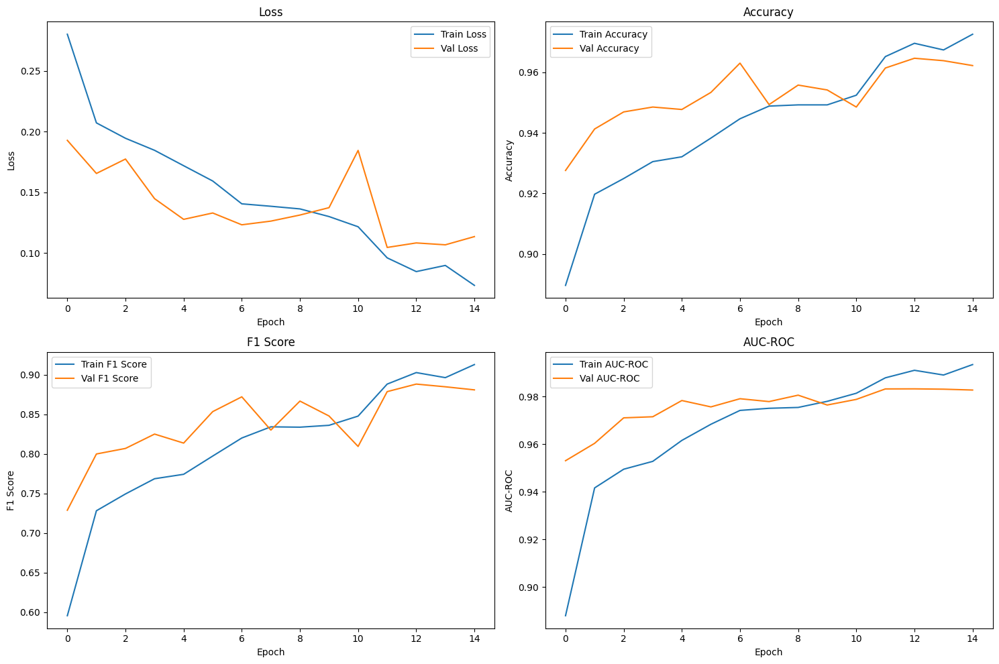

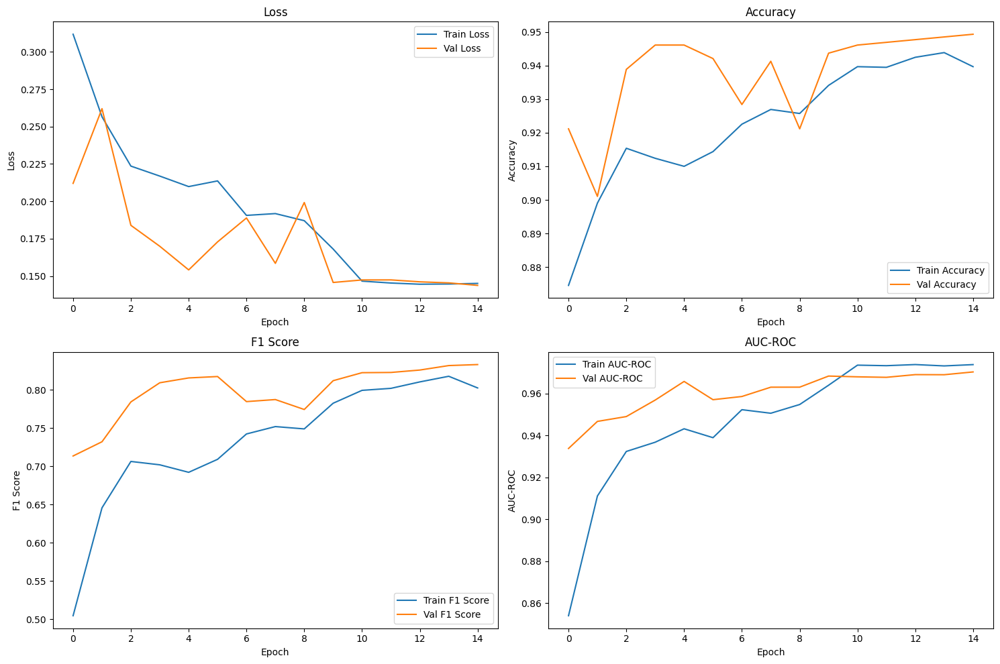

Generating predictions: 100%|██████████| 78/78 [00:17<00:00,  4.45it/s]


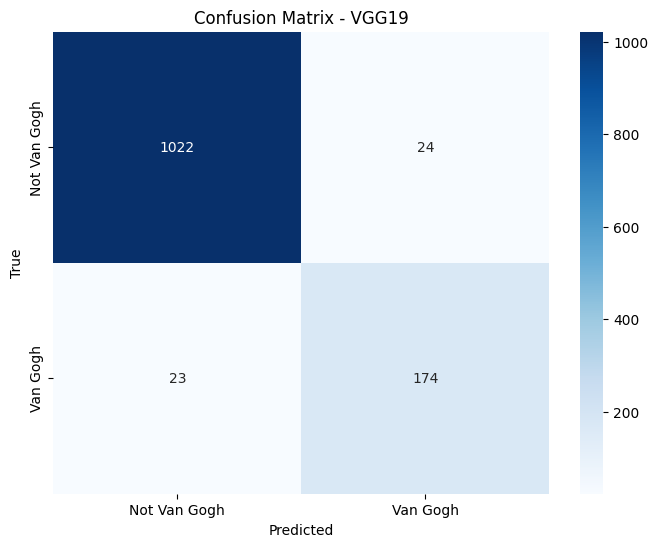

Generating predictions: 100%|██████████| 78/78 [00:15<00:00,  4.88it/s]


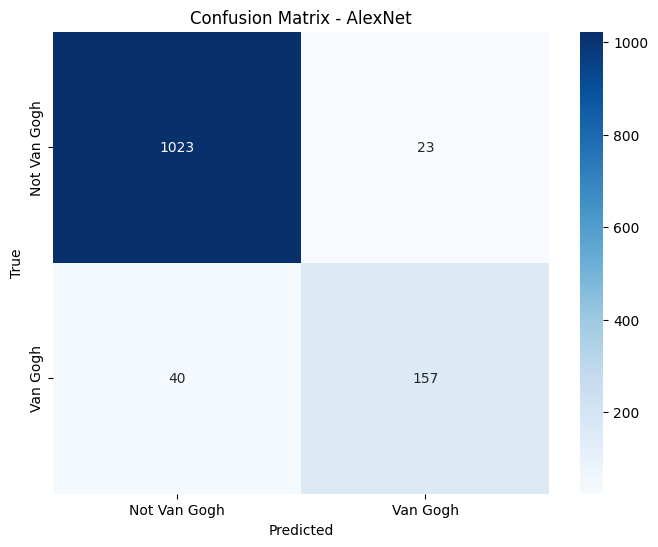


Model Performance Comparison:
VGG19 Best Validation AUC: 0.9833
AlexNet Best Validation AUC: 0.9704
VGG19 performs better in detecting Van Gogh paintings!

Training completed successfully!


In [7]:
import os
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
from PIL import Image
import optuna
import time
from tqdm import tqdm
import seaborn as sns

# Define paths and device
PAINTINGS_PATH = "/kaggle/input/wikiart/"
CSV_PATH = "/kaggle/input/labelss/filtered_class.csv"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set random seed for reproducibility
SEED = 42
torch.manual_seed(SEED)
np.random.seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)

# Custom dataset class
class WikiArtDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None, subset='train'):
        self.data_frame = pd.read_csv(csv_file)
        # Filter by subset first
        self.data_frame = self.data_frame[self.data_frame['subset'] == subset].reset_index(drop=True)
        self.root_dir = root_dir
        self.transform = transform
        
        # Extract labels (1 if Van Gogh, 0 otherwise)
        self.data_frame['is_van_gogh'] = self.data_frame['artist'].apply(
            lambda x: 1 if 'van gogh' in x.lower() else 0  # Case-insensitive check
        )
        
        # Check if images exist and filter out missing ones
        valid_rows = []
        print(f"Checking for valid images in {subset} set...")
        total_images = len(self.data_frame)
        valid_count = 0
        
        for idx, row in tqdm(self.data_frame.iterrows(), total=total_images):
            img_path = os.path.join(self.root_dir, row['filename'])
            if os.path.exists(img_path):
                valid_rows.append(row)
                valid_count += 1
        
        # Create a new DataFrame with only valid images
        self.valid_data = pd.DataFrame(valid_rows) if valid_rows else pd.DataFrame(columns=self.data_frame.columns)
        
        print(f"Found {valid_count} valid images out of {total_images} in {subset} set")
        
    def __len__(self):
        return len(self.valid_data)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        
        img_name = self.valid_data.iloc[idx]['filename']
        img_path = os.path.join(self.root_dir, img_name)
        
        try:
            image = Image.open(img_path).convert('RGB')
            
            if self.transform:
                image = self.transform(image)
                
            label = self.valid_data.iloc[idx]['is_van_gogh']
            return image, label
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            # Return a placeholder if image loading fails
            if self.transform:
                placeholder = torch.zeros(3, 224, 224)
                return placeholder, 0
            else:
                return None, 0

# Define transformations for training and validation
def get_transforms(augmentation=True):
    # Basic transformations for validation
    val_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    # Additional augmentations for training
    if augmentation:
        train_transform = transforms.Compose([
            transforms.RandomResizedCrop(224),
            transforms.RandomHorizontalFlip(),
            transforms.RandomVerticalFlip(p=0.2),
            transforms.RandomRotation(15),
            transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        return train_transform, val_transform
    else:
        return val_transform, val_transform

# Define model
class FineTunedModel(nn.Module):
    def __init__(self, base_model='vgg19', pretrained=True):
        super(FineTunedModel, self).__init__()
        
        if base_model == 'vgg19':
            self.base_model = models.vgg19(pretrained=pretrained)
            num_features = self.base_model.classifier[6].in_features
            self.base_model.classifier[6] = nn.Linear(num_features, 1)
        elif base_model == 'alexnet':
            self.base_model = models.alexnet(pretrained=pretrained)
            num_features = self.base_model.classifier[6].in_features
            self.base_model.classifier[6] = nn.Linear(num_features, 1)
        else:
            raise ValueError(f"Unsupported base model: {base_model}")
    
    def forward(self, x):
        x = self.base_model(x)
        return x

# Training function
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, model_name, num_epochs=10):
    best_val_auc = 0.0
    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_f1': [], 'val_f1': [],
        'train_auc': [], 'val_auc': []
    }
    
    for epoch in range(num_epochs):
        start_time = time.time()
        
        # Training phase
        model.train()
        train_loss = 0.0
        train_preds = []
        train_labels = []
        
        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]"):
            inputs = inputs.to(DEVICE)
            labels = labels.float().to(DEVICE).view(-1, 1)
            
            # Zero the parameter gradients
            optimizer.zero_grad()
            
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            # Backward pass and optimize
            loss.backward()
            optimizer.step()
            
            # Statistics
            train_loss += loss.item() * inputs.size(0)
            train_preds.extend(torch.sigmoid(outputs).cpu().detach().numpy())
            train_labels.extend(labels.cpu().numpy())
        
        train_loss = train_loss / len(train_loader.dataset)
        train_preds = np.array(train_preds).flatten()
        train_labels = np.array(train_labels).flatten()
        train_pred_classes = (train_preds >= 0.5).astype(int)
        
        train_acc = accuracy_score(train_labels, train_pred_classes)
        
        # Safe calculation of F1 and AUC metrics
        if len(np.unique(train_labels)) > 1:
            train_f1 = f1_score(train_labels, train_pred_classes)
            train_auc = roc_auc_score(train_labels, train_preds)
        else:
            train_f1 = 0.0
            train_auc = 0.5  
        
        # Validation phase
        model.eval()
        val_loss = 0.0
        val_preds = []
        val_labels = []
        
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Val]"):
                inputs = inputs.to(DEVICE)
                labels = labels.float().to(DEVICE).view(-1, 1)
                
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                
                val_loss += loss.item() * inputs.size(0)
                val_preds.extend(torch.sigmoid(outputs).cpu().numpy())
                val_labels.extend(labels.cpu().numpy())
        
        val_loss = val_loss / len(val_loader.dataset)
        val_preds = np.array(val_preds).flatten()
        val_labels = np.array(val_labels).flatten()
        val_pred_classes = (val_preds >= 0.5).astype(int)
        
        val_acc = accuracy_score(val_labels, val_pred_classes)
        
        # Safe calculation of F1 and AUC metrics for validation
        if len(np.unique(val_labels)) > 1:
            val_f1 = f1_score(val_labels, val_pred_classes)
            val_auc = roc_auc_score(val_labels, val_preds)
        else:
            val_f1 = 0.0
            val_auc = 0.5  
        
        # Update scheduler
        if scheduler:
            scheduler.step(val_loss)
        
        # Save metrics
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)
        history['train_auc'].append(train_auc)
        history['val_auc'].append(val_auc)
        
        epoch_time = time.time() - start_time
        
        # Print metrics
        print(f"Epoch {epoch+1}/{num_epochs} | Time: {epoch_time:.2f}s")
        print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
        print(f"Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")
        print(f"Train F1: {train_f1:.4f} | Val F1: {val_f1:.4f}")
        print(f"Train AUC: {train_auc:.4f} | Val AUC: {val_auc:.4f}")
        print("-" * 50)
        
        # Save best model - use the passed model_name parameter
        if val_auc > best_val_auc:
            best_val_auc = val_auc
            torch.save(model.state_dict(), f"best_model_{model_name}.pth")
            print(f"Saved new best model with VAL AUC: {best_val_auc:.4f}")
    
    return history

# Function for K-fold cross validation
def perform_kfold(model_type, dataset, k=5, batch_size=16, num_epochs=10, lr=0.001):
    # Extract all labels for stratification
    all_labels = [dataset[i][1] for i in range(len(dataset))]
    
    # Use StratifiedKFold instead of regular KFold
    from sklearn.model_selection import StratifiedKFold
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=SEED)
    fold_results = []
    
    # Get all indices
    indices = list(range(len(dataset)))
    
    for fold, (train_idx, val_idx) in enumerate(skf.split(indices, all_labels)):
        print(f"{'='*20} Fold {fold+1}/{k} {'='*20}")
        
        # Create data samplers
        train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
        val_sampler = torch.utils.data.SubsetRandomSampler(val_idx)
        
        # Create data loaders
        train_loader = DataLoader(
            dataset, batch_size=batch_size, sampler=train_sampler, num_workers=4
        )
        val_loader = DataLoader(
            dataset, batch_size=batch_size, sampler=val_sampler, num_workers=4
        )
        
        # Initialize model, criterion, optimizer, and scheduler
        model = FineTunedModel(base_model=model_type, pretrained=True).to(DEVICE)
        criterion = nn.BCEWithLogitsLoss()
        optimizer = optim.Adam(model.parameters(), lr=lr)
        scheduler = optim.lr_scheduler.ReduceLROnPlateau(
            optimizer, mode='min', factor=0.1, patience=3, verbose=True
        )
        
        # Train the model
        history = train_model(
            model, train_loader, val_loader, criterion, optimizer, scheduler, 
            model_name=f"{model_type}_fold{fold+1}", num_epochs=num_epochs
        )
        
        # Get the best validation AUC from this fold
        best_val_auc = max(history['val_auc'])
        fold_results.append(best_val_auc)
        
        print(f"Fold {fold+1} best validation AUC: {best_val_auc:.4f}")
    
    # Print overall results
    avg_auc = sum(fold_results) / len(fold_results)
    print(f"Average validation AUC across {k} folds: {avg_auc:.4f}")
    
    return fold_results, avg_auc

# Optuna objective function for hyperparameter tuning
def objective(trial, model_type, train_dataset, val_dataset):
    # Hyperparameters to tune
    batch_size = trial.suggest_categorical('batch_size', [8, 16, 32])
    lr = trial.suggest_float('lr', 1e-5, 1e-3, log=True)
    weight_decay = trial.suggest_float('weight_decay', 1e-6, 1e-3, log=True)
    
    # Create data loaders
    train_loader = DataLoader(
        train_dataset, batch_size=batch_size, shuffle=True, num_workers=4
    )
    val_loader = DataLoader(
        val_dataset, batch_size=batch_size, shuffle=False, num_workers=4
    )
    
    # Initialize model, criterion, optimizer, and scheduler
    model = FineTunedModel(base_model=model_type, pretrained=True).to(DEVICE)
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='min', factor=0.1, patience=3, verbose=True
    )
    
    # Train the model
    history = train_model(
        model, train_loader, val_loader, criterion, optimizer, scheduler, 
        model_name=model_type, num_epochs=5
    )
    
    # Handle the case when no AUC was calculated (only one class in validation)
    if len(history['val_auc']) == 0 or max(history['val_auc']) == 0.5:
        return 0.0  # Return a default poor score
    
    # Return the best validation AUC
    return max(history['val_auc'])

# Function to plot performance metrics
def plot_metrics(history, model_name):
    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    
    # Plot loss
    axs[0, 0].plot(history['train_loss'], label='Train Loss')
    axs[0, 0].plot(history['val_loss'], label='Val Loss')
    axs[0, 0].set_title('Loss')
    axs[0, 0].set_xlabel('Epoch')
    axs[0, 0].set_ylabel('Loss')
    axs[0, 0].legend()
    
    # Plot accuracy
    axs[0, 1].plot(history['train_acc'], label='Train Accuracy')
    axs[0, 1].plot(history['val_acc'], label='Val Accuracy')
    axs[0, 1].set_title('Accuracy')
    axs[0, 1].set_xlabel('Epoch')
    axs[0, 1].set_ylabel('Accuracy')
    axs[0, 1].legend()
    
    # Plot F1 score
    axs[1, 0].plot(history['train_f1'], label='Train F1 Score')
    axs[1, 0].plot(history['val_f1'], label='Val F1 Score')
    axs[1, 0].set_title('F1 Score')
    axs[1, 0].set_xlabel('Epoch')
    axs[1, 0].set_ylabel('F1 Score')
    axs[1, 0].legend()
    
    # Plot AUC-ROC
    axs[1, 1].plot(history['train_auc'], label='Train AUC-ROC')
    axs[1, 1].plot(history['val_auc'], label='Val AUC-ROC')
    axs[1, 1].set_title('AUC-ROC')
    axs[1, 1].set_xlabel('Epoch')
    axs[1, 1].set_ylabel('AUC-ROC')
    axs[1, 1].legend()
    
    plt.tight_layout()
    plt.savefig(f"{model_name}_metrics.png")
    plt.show()

# Function to visualize confusion matrix
def plot_confusion_matrix(model, test_loader, model_name):
    model.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc="Generating predictions"):
            inputs = inputs.to(DEVICE)
            outputs = model(inputs)
            preds = (torch.sigmoid(outputs) >= 0.5).cpu().numpy()
            
            all_preds.extend(preds.flatten())
            all_labels.extend(labels.numpy())
    
    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['Not Van Gogh', 'Van Gogh'],
                yticklabels=['Not Van Gogh', 'Van Gogh'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.savefig(f"{model_name}_confusion_matrix.png")
    plt.show()

# Main function to orchestrate the workflow
def main():
    print(f"Using device: {DEVICE}")
    
    # Load and prepare data
    print("Loading and preparing data...")
    train_transform, val_transform = get_transforms(augmentation=True)
    
    # Create datasets
    train_dataset = WikiArtDataset(
        csv_file=CSV_PATH,
        root_dir=PAINTINGS_PATH,
        transform=train_transform,
        subset='train'
    )
    
    test_dataset = WikiArtDataset(
        csv_file=CSV_PATH,
        root_dir=PAINTINGS_PATH,
        transform=val_transform,
        subset='test'
    )
    
    # Check if datasets are non-empty
    if len(train_dataset) == 0:
        raise ValueError("No valid training images found. Please check the paths and CSV file.")
    
    if len(test_dataset) == 0:
        raise ValueError("No valid test images found. Please check the paths and CSV file.")
    
    # Print class distribution
    train_labels = [train_dataset[i][1] for i in range(len(train_dataset))]
    test_labels = [test_dataset[i][1] for i in range(len(test_dataset))]
    
    print(f"Train set class distribution: Van Gogh = {sum(train_labels)}, Not Van Gogh = {len(train_labels) - sum(train_labels)}")
    print(f"Test set class distribution: Van Gogh = {sum(test_labels)}, Not Van Gogh = {len(test_labels) - sum(test_labels)}")
    
    # Create data loaders for final evaluation
    test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=4)
    
    # Perform hyperparameter tuning with Optuna
    print("\nStarting hyperparameter tuning with Optuna...")
    
    # VGG19 tuning
    vgg_study = optuna.create_study(direction='maximize')
    vgg_study.optimize(lambda trial: objective(trial, 'vgg19', train_dataset, test_dataset), n_trials=5)
    
    print(f"Best VGG19 hyperparameters: {vgg_study.best_params}")
    print(f"Best VGG19 validation AUC: {vgg_study.best_value:.4f}")
    
    # AlexNet tuning
    alexnet_study = optuna.create_study(direction='maximize')
    alexnet_study.optimize(lambda trial: objective(trial, 'alexnet', train_dataset, test_dataset), n_trials=5)
    
    print(f"Best AlexNet hyperparameters: {alexnet_study.best_params}")
    print(f"Best AlexNet validation AUC: {alexnet_study.best_value:.4f}")
    
    # Perform K-fold cross-validation
    print("\nPerforming K-fold cross-validation...")
    
    # VGG19 cross-validation
    print("VGG19 K-fold cross-validation:")
    vgg_fold_results, vgg_avg_auc = perform_kfold(
        'vgg19', train_dataset, k=5, 
        batch_size=vgg_study.best_params['batch_size'], 
        lr=vgg_study.best_params['lr']
    )
    
    # AlexNet cross-validation
    print("AlexNet K-fold cross-validation:")
    alexnet_fold_results, alexnet_avg_auc = perform_kfold(
        'alexnet', train_dataset, k=5, 
        batch_size=alexnet_study.best_params['batch_size'], 
        lr=alexnet_study.best_params['lr']
    )
    
    # Final training and evaluation
    print("\nFinal training and evaluation...")
    
    # Train final VGG19 model
    vgg19_model = FineTunedModel(base_model='vgg19', pretrained=True).to(DEVICE)
    vgg19_optimizer = optim.Adam(
        vgg19_model.parameters(), 
        lr=vgg_study.best_params['lr'], 
        weight_decay=vgg_study.best_params['weight_decay']
    )
    vgg19_scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        vgg19_optimizer, mode='min', factor=0.1, patience=3, verbose=True
    )
    
    train_loader = DataLoader(
        train_dataset, batch_size=vgg_study.best_params['batch_size'], 
        shuffle=True, num_workers=4
    )
    
    print("Training final VGG19 model...")
    vgg19_history = train_model(
        vgg19_model, train_loader, test_loader, nn.BCEWithLogitsLoss(), 
        vgg19_optimizer, vgg19_scheduler, model_name="vgg19", num_epochs=15
    )
    
    # Train final AlexNet model
    alexnet_model = FineTunedModel(base_model='alexnet', pretrained=True).to(DEVICE)
    alexnet_optimizer = optim.Adam(
        alexnet_model.parameters(), 
        lr=alexnet_study.best_params['lr'], 
        weight_decay=alexnet_study.best_params['weight_decay']
    )
    alexnet_scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        alexnet_optimizer, mode='min', factor=0.1, patience=3, verbose=True
    )
    
    train_loader = DataLoader(
        train_dataset, batch_size=alexnet_study.best_params['batch_size'], 
        shuffle=True, num_workers=4
    )
    
    print("Training final AlexNet model...")
    alexnet_history = train_model(
        alexnet_model, train_loader, test_loader, nn.BCEWithLogitsLoss(), 
        alexnet_optimizer, alexnet_scheduler, model_name="alexnet", num_epochs=15
    )
    
    # Plot metrics
    plot_metrics(vgg19_history, "VGG19")
    plot_metrics(alexnet_history, "AlexNet")
    
    # Visualize confusion matrices
    plot_confusion_matrix(vgg19_model, test_loader, "VGG19")
    plot_confusion_matrix(alexnet_model, test_loader, "AlexNet")
    
    # Compare model performance
    print("\nModel Performance Comparison:")
    print(f"VGG19 Best Validation AUC: {max(vgg19_history['val_auc']):.4f}")
    print(f"AlexNet Best Validation AUC: {max(alexnet_history['val_auc']):.4f}")
    
    if max(vgg19_history['val_auc']) > max(alexnet_history['val_auc']):
        print("VGG19 performs better in detecting Van Gogh paintings!")
    else:
        print("AlexNet performs better in detecting Van Gogh paintings!")

    print("\nTraining completed successfully!")

# Run the main function
if __name__ == "__main__":
    main()

**best_model_vgg19 Visualization**

Using device: cuda
Loading data...
Available columns in the CSV: ['filename', 'artist', 'genre', 'description', 'phash', 'width', 'height', 'genre_count', 'subset']
Loading model...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
<ipython-input-18-15e30a509a8b>:49: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the function

Visualizing random predictions...


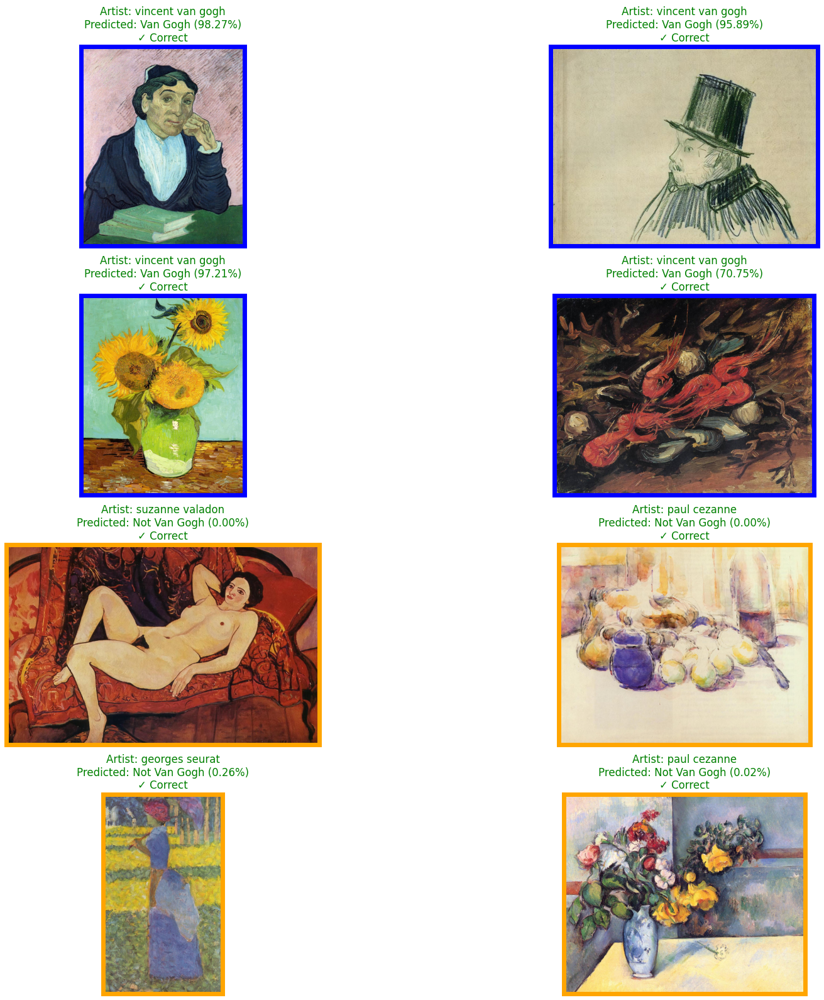

Finding and visualizing challenging examples...


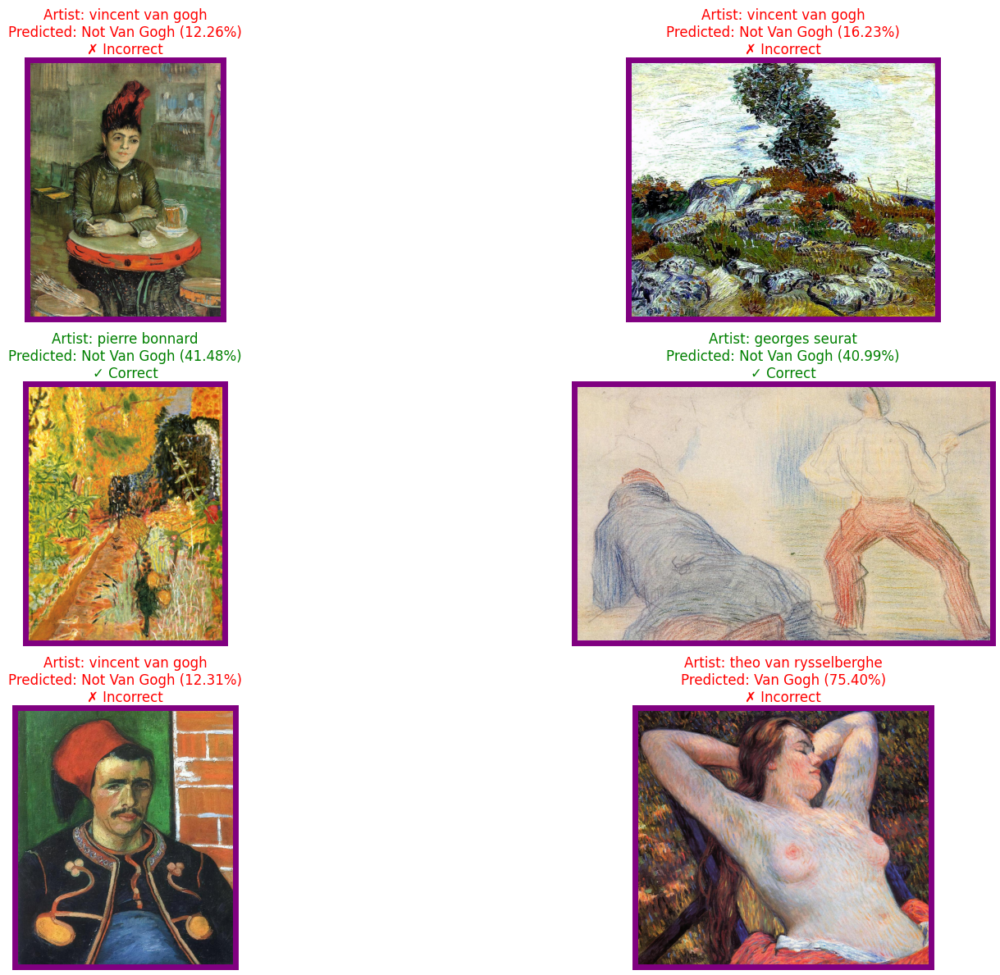

Visualizing activation maps for: vincent van gogh
pytorch-grad-cam not installed. Install with: pip install pytorch-grad-cam
Visualization complete!


In [18]:
import os
import random
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
from torchvision import models, transforms
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

# Define paths and device
PAINTINGS_PATH = "/kaggle/input/wikiart/"
CSV_PATH = "/kaggle/input/labelss/filtered_class.csv"
MODEL_PATH = "/kaggle/working/best_model_vgg19.pth"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define the model class (same as in your training code)
class FineTunedModel(nn.Module):
    def __init__(self, base_model='vgg19', pretrained=True):
        super(FineTunedModel, self).__init__()
        
        if base_model == 'vgg19':
            self.base_model = models.vgg19(pretrained=pretrained)
            num_features = self.base_model.classifier[6].in_features
            self.base_model.classifier[6] = nn.Linear(num_features, 1)
        elif base_model == 'alexnet':
            self.base_model = models.alexnet(pretrained=pretrained)
            num_features = self.base_model.classifier[6].in_features
            self.base_model.classifier[6] = nn.Linear(num_features, 1)
        else:
            raise ValueError(f"Unsupported base model: {base_model}")
    
    def forward(self, x):
        x = self.base_model(x)
        return x

# Define image transformation (same as validation transform)
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Function to load model
def load_model(model_path):
    model = FineTunedModel(base_model='vgg19', pretrained=False).to(DEVICE)
    model.load_state_dict(torch.load(model_path))
    model.eval()
    return model

# Function to get predictions for a single image
def predict_image(model, image_path):
    try:
        image = Image.open(image_path).convert('RGB')
        image_tensor = transform(image).unsqueeze(0).to(DEVICE)
        
        with torch.no_grad():
            output = model(image_tensor)
            probability = torch.sigmoid(output).item()
        
        return probability, image
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return None, None

# Function to visualize predictions for multiple images
def visualize_predictions(model, dataframe, num_samples=8, include_van_gogh=True):
    # Filter dataframe to include both Van Gogh and non-Van Gogh paintings
    van_gogh_df = dataframe[dataframe['artist'].str.lower().str.contains('van gogh')]
    non_van_gogh_df = dataframe[~dataframe['artist'].str.lower().str.contains('van gogh')]
    
    # Determine how many samples of each category to include
    if include_van_gogh:
        num_van_gogh = min(num_samples // 2, len(van_gogh_df))
        num_non_van_gogh = num_samples - num_van_gogh
    else:
        num_van_gogh = 0
        num_non_van_gogh = num_samples
    
    # Sample random paintings
    van_gogh_samples = van_gogh_df.sample(num_van_gogh) if num_van_gogh > 0 else pd.DataFrame()
    non_van_gogh_samples = non_van_gogh_df.sample(num_non_van_gogh) if num_non_van_gogh > 0 else pd.DataFrame()
    
    # Combine samples
    samples = pd.concat([van_gogh_samples, non_van_gogh_samples])
    
    # Prepare figure for plotting
    fig = plt.figure(figsize=(20, 4 * ((num_samples + 1) // 2)))
    gs = GridSpec(((num_samples + 1) // 2), 2, figure=fig)
    
    # Counter for successfully processed images
    processed_count = 0
    
    # Process each sample
    for i, (_, row) in enumerate(samples.iterrows()):
        if processed_count >= num_samples:
            break
            
        img_path = os.path.join(PAINTINGS_PATH, row['filename'])
        
        if not os.path.exists(img_path):
            print(f"Image not found: {img_path}")
            continue
        
        # Get prediction
        prob, img = predict_image(model, img_path)
        
        if prob is None or img is None:
            continue
        
        # Determine grid position
        ax = fig.add_subplot(gs[processed_count // 2, processed_count % 2])
        
        # Plot image
        ax.imshow(img)
        
        # Add prediction information
        is_van_gogh = 'van gogh' in row['artist'].lower()
        prediction = "Van Gogh" if prob >= 0.5 else "Not Van Gogh"
        correct = (is_van_gogh and prob >= 0.5) or (not is_van_gogh and prob < 0.5)
        
        # Set title with prediction information
        title = f"Artist: {row['artist']}\n"
        title += f"Predicted: {prediction} ({prob:.2%})\n"
        title += f"{'✓ Correct' if correct else '✗ Incorrect'}"
        
        # Color code the title based on correctness
        title_color = 'green' if correct else 'red'
        ax.set_title(title, color=title_color)
        
        # Remove axis ticks
        ax.set_xticks([])
        ax.set_yticks([])
        
        # Add border color based on prediction
        border_color = 'blue' if prob >= 0.5 else 'orange'
        for spine in ax.spines.values():
            spine.set_edgecolor(border_color)
            spine.set_linewidth(5)
        
        processed_count += 1
    
    plt.tight_layout()
    plt.savefig('van_gogh_predictions.png')
    plt.show()

# Function to visualize model's confidence on challenging examples
def visualize_challenging_examples(model, dataframe, threshold=0.6, num_samples=6):
    """
    Find and visualize examples where the model's confidence is close to the decision boundary
    """
    # Add 'is_van_gogh' column
    dataframe['is_van_gogh'] = dataframe['artist'].str.lower().str.contains('van gogh').astype(int)
    
    # Create empty lists to store results
    challenging_examples = []
    
    # Process a subset of images to find challenging examples
    sample_size = min(1000, len(dataframe))
    for _, row in dataframe.sample(sample_size).iterrows():
        img_path = os.path.join(PAINTINGS_PATH, row['filename'])
        
        if not os.path.exists(img_path):
            continue
        
        # Get prediction
        prob, _ = predict_image(model, img_path)
        
        if prob is None:
            continue
        
        # Check if this is a challenging example
        is_challenging = False
        if row['is_van_gogh'] == 1 and prob < threshold:
            # Van Gogh but predicted with low confidence
            is_challenging = True
        elif row['is_van_gogh'] == 0 and prob > (1-threshold):
            # Not Van Gogh but predicted as Van Gogh with high confidence
            is_challenging = True
        
        if is_challenging:
            challenging_examples.append((row, prob, img_path))
            if len(challenging_examples) >= num_samples:
                break
    
    # Visualize challenging examples
    if challenging_examples:
        fig = plt.figure(figsize=(20, 4 * ((len(challenging_examples) + 1) // 2)))
        gs = GridSpec(((len(challenging_examples) + 1) // 2), 2, figure=fig)
        
        for i, (row, prob, img_path) in enumerate(challenging_examples):
            # Get image
            img = Image.open(img_path).convert('RGB')
            
            # Determine grid position
            ax = fig.add_subplot(gs[i // 2, i % 2])
            
            # Plot image
            ax.imshow(img)
            
            # Add prediction information
            is_van_gogh = row['is_van_gogh'] == 1
            prediction = "Van Gogh" if prob >= 0.5 else "Not Van Gogh"
            correct = (is_van_gogh and prob >= 0.5) or (not is_van_gogh and prob < 0.5)
            
            # Set title with prediction information
            title = f"Artist: {row['artist']}\n"
            title += f"Predicted: {prediction} ({prob:.2%})\n"
            title += f"{'✓ Correct' if correct else '✗ Incorrect'}"
            
            # Color code the title based on correctness
            title_color = 'green' if correct else 'red'
            ax.set_title(title, color=title_color)
            
            # Remove axis ticks
            ax.set_xticks([])
            ax.set_yticks([])
            
            # Add border color based on confidence
            border_color = 'purple'  # Purple for challenging examples
            for spine in ax.spines.values():
                spine.set_edgecolor(border_color)
                spine.set_linewidth(5)
        
        plt.tight_layout()
        plt.savefig('challenging_examples.png')
        plt.show()
    else:
        print("No challenging examples found within the sample size.")

# Function to visualize activation maps (feature visualizations)
def visualize_activation_maps(model, image_path, image_name="Selected painting"):
    """Visualize activation maps for a single image using Grad-CAM technique"""
    try:
        # Import required libraries for Grad-CAM
        from pytorch_grad_cam import GradCAM
        from pytorch_grad_cam.utils.image import show_cam_on_image
        
        # Prepare image
        image = Image.open(image_path).convert('RGB')
        input_tensor = transform(image).unsqueeze(0).to(DEVICE)
        
        # Get prediction
        with torch.no_grad():
            output = model(input_tensor)
            probability = torch.sigmoid(output).item()
        
        # Target layer for VGG19 (features.36 is the last conv layer)
        target_layer = model.base_model.features[-1]
        
        # Setup Grad-CAM
        cam = GradCAM(model=model, target_layer=target_layer, use_cuda=torch.cuda.is_available())
        
        # Generate activation map
        grayscale_cam = cam(input_tensor=input_tensor, target_category=0)
        grayscale_cam = grayscale_cam[0, :]
        
        # Convert back to numpy for visualization
        rgb_img = np.array(image.resize((224, 224))) / 255.0
        
        # Overlay activation map on image
        visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
        
        # Plot original and activation map
        fig, ax = plt.subplots(1, 2, figsize=(12, 6))
        
        # Original image
        ax[0].imshow(rgb_img)
        ax[0].set_title(f"Original (Probability: {probability:.2%})")
        ax[0].axis('off')
        
        # Activation map
        ax[1].imshow(visualization)
        ax[1].set_title("Activation Map")
        ax[1].axis('off')
        
        plt.savefig('activation_map.png')
        plt.show()
        
    except ImportError:
        print("pytorch-grad-cam not installed. Install with: pip install pytorch-grad-cam")
    except Exception as e:
        print(f"Error generating activation map: {e}")

# Main function
def main():
    print(f"Using device: {DEVICE}")
    
    # Load the CSV file
    print("Loading data...")
    data = pd.read_csv(CSV_PATH)
    
    # Check available columns in the DataFrame
    print(f"Available columns in the CSV: {data.columns.tolist()}")
    
    # Load the trained model
    print("Loading model...")
    model = load_model(MODEL_PATH)
    
    # Visualize random predictions
    print("Visualizing random predictions...")
    visualize_predictions(model, data, num_samples=8, include_van_gogh=True)
    
    # Visualize challenging examples
    print("Finding and visualizing challenging examples...")
    visualize_challenging_examples(model, data)
    
    # Optionally visualize activation maps for a specific image
    # First, find a Van Gogh painting
    van_gogh_sample = data[data['artist'].str.lower().str.contains('van gogh')].sample(1).iloc[0]
    img_path = os.path.join(PAINTINGS_PATH, van_gogh_sample['filename'])
    
    if os.path.exists(img_path):
        print(f"Visualizing activation maps for: {van_gogh_sample['artist']}")
        try:
            visualize_activation_maps(model, img_path)
        except Exception as e:
            print(f"Could not generate activation map: {e}")
            print("If you want to use this feature, install pytorch-grad-cam: pip install pytorch-grad-cam")
    
    print("Visualization complete!")

if __name__ == "__main__":
    main()

**Task 02**

Using device: cuda

Processing Content Image 1/1: pexels-agus-66107
Style Image 1/5: vincent-van-gogh_a-field-of-yellow-flowers-1889(1)

Running VGG19 Style Transfer...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:02<00:00, 198MB/s] 


Performing style transfer using vgg19...


Style Transfer (vgg19):  17%|█▋        | 50/300 [01:10<06:07,  1.47s/it]

Iteration: 50
Style Loss: 2.0047
Content Loss: 39.1206
Total Loss: 41.1253
-------------------


Style Transfer (vgg19):  33%|███▎      | 100/300 [02:29<05:39,  1.70s/it]

Iteration: 100
Style Loss: 2.0047
Content Loss: 38.9763
Total Loss: 40.9809
-------------------


Style Transfer (vgg19):  50%|█████     | 150/300 [03:56<04:17,  1.71s/it]

Iteration: 150
Style Loss: 2.0043
Content Loss: 38.9324
Total Loss: 40.9367
-------------------


Style Transfer (vgg19):  67%|██████▋   | 200/300 [05:23<02:52,  1.72s/it]

Iteration: 200
Style Loss: 2.0046
Content Loss: 38.9102
Total Loss: 40.9147
-------------------


Style Transfer (vgg19):  83%|████████▎ | 250/300 [06:50<01:27,  1.75s/it]

Iteration: 250
Style Loss: 2.0040
Content Loss: 38.8975
Total Loss: 40.9015
-------------------


Style Transfer (vgg19): 100%|██████████| 300/300 [08:11<00:00,  1.64s/it]


Iteration: 300
Style Loss: 2.0039
Content Loss: 38.8886
Total Loss: 40.8925
-------------------

Running AlexNet Style Transfer...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 230MB/s] 


Performing style transfer using alexnet...


Style Transfer (alexnet):  17%|█▋        | 50/300 [00:24<02:20,  1.78it/s]

Iteration: 50
Style Loss: 4.6224
Content Loss: 9.0002
Total Loss: 13.6225
-------------------


Style Transfer (alexnet):  33%|███▎      | 100/300 [00:52<01:52,  1.79it/s]

Iteration: 100
Style Loss: 1.6872
Content Loss: 8.2349
Total Loss: 9.9220
-------------------


Style Transfer (alexnet):  50%|█████     | 150/300 [01:19<01:23,  1.79it/s]

Iteration: 150
Style Loss: 1.4256
Content Loss: 8.0273
Total Loss: 9.4530
-------------------


Style Transfer (alexnet):  67%|██████▋   | 200/300 [01:47<00:56,  1.78it/s]

Iteration: 200
Style Loss: 1.3290
Content Loss: 7.9324
Total Loss: 9.2614
-------------------


Style Transfer (alexnet):  83%|████████▎ | 250/300 [02:15<00:26,  1.87it/s]

Iteration: 250
Style Loss: 1.2823
Content Loss: 7.8720
Total Loss: 9.1543
-------------------


Style Transfer (alexnet): 100%|██████████| 300/300 [02:42<00:00,  1.84it/s]


Iteration: 300
Style Loss: 1.2509
Content Loss: 7.8299
Total Loss: 9.0808
-------------------


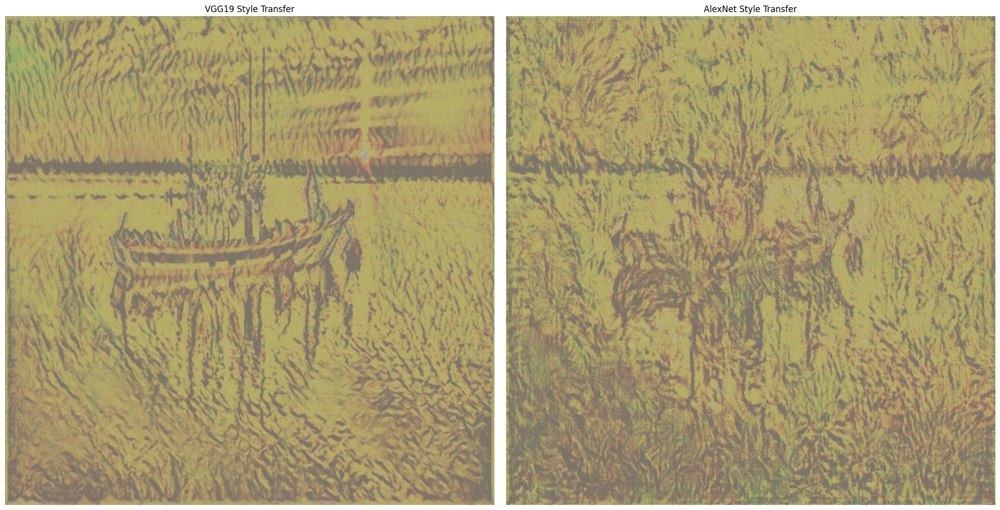


Processing Content Image 1/1: pexels-agus-66107
Style Image 2/5: vincent-van-gogh_a-fishing-boat-at-sea-1888(1)

Running VGG19 Style Transfer...
Performing style transfer using vgg19...


Style Transfer (vgg19):  17%|█▋        | 50/300 [01:26<07:10,  1.72s/it]

Iteration: 50
Style Loss: 1.6939
Content Loss: 27.1576
Total Loss: 28.8515
-------------------


Style Transfer (vgg19):  33%|███▎      | 100/300 [02:53<05:49,  1.75s/it]

Iteration: 100
Style Loss: 1.6804
Content Loss: 27.0043
Total Loss: 28.6847
-------------------


Style Transfer (vgg19):  50%|█████     | 150/300 [04:20<04:19,  1.73s/it]

Iteration: 150
Style Loss: 1.6770
Content Loss: 26.9612
Total Loss: 28.6383
-------------------


Style Transfer (vgg19):  67%|██████▋   | 200/300 [05:47<02:52,  1.73s/it]

Iteration: 200
Style Loss: 1.6758
Content Loss: 26.9392
Total Loss: 28.6150
-------------------


Style Transfer (vgg19):  83%|████████▎ | 250/300 [07:13<01:27,  1.74s/it]

Iteration: 250
Style Loss: 1.6747
Content Loss: 26.9258
Total Loss: 28.6006
-------------------


Style Transfer (vgg19): 100%|██████████| 300/300 [08:41<00:00,  1.74s/it]


Iteration: 300
Style Loss: 1.6742
Content Loss: 26.9167
Total Loss: 28.5909
-------------------

Running AlexNet Style Transfer...
Performing style transfer using alexnet...


Style Transfer (alexnet):  17%|█▋        | 50/300 [00:25<02:18,  1.80it/s]

Iteration: 50
Style Loss: 8.1994
Content Loss: 8.6453
Total Loss: 16.8448
-------------------


Style Transfer (alexnet):  33%|███▎      | 100/300 [00:53<01:51,  1.79it/s]

Iteration: 100
Style Loss: 2.2848
Content Loss: 7.6623
Total Loss: 9.9471
-------------------


Style Transfer (alexnet):  50%|█████     | 150/300 [01:20<01:23,  1.80it/s]

Iteration: 150
Style Loss: 1.8165
Content Loss: 7.4222
Total Loss: 9.2386
-------------------


Style Transfer (alexnet):  67%|██████▋   | 200/300 [01:48<00:55,  1.80it/s]

Iteration: 200
Style Loss: 1.6828
Content Loss: 7.3133
Total Loss: 8.9961
-------------------


Style Transfer (alexnet):  83%|████████▎ | 250/300 [02:16<00:28,  1.79it/s]

Iteration: 250
Style Loss: 1.6209
Content Loss: 7.2471
Total Loss: 8.8681
-------------------


Style Transfer (alexnet): 100%|██████████| 300/300 [02:44<00:00,  1.82it/s]


Iteration: 300
Style Loss: 1.5857
Content Loss: 7.1979
Total Loss: 8.7836
-------------------


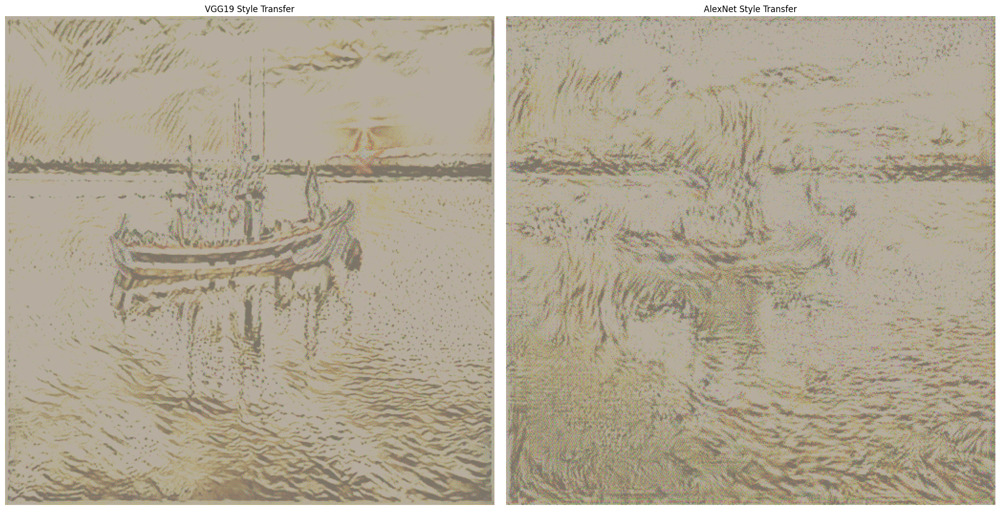


Processing Content Image 1/1: pexels-agus-66107
Style Image 3/5: vincent-van-gogh_a-fishing-boat-at-sea-1888-2(1)

Running VGG19 Style Transfer...
Performing style transfer using vgg19...


Style Transfer (vgg19):  17%|█▋        | 50/300 [01:26<07:11,  1.72s/it]

Iteration: 50
Style Loss: 1.7974
Content Loss: 31.2814
Total Loss: 33.0788
-------------------


Style Transfer (vgg19):  33%|███▎      | 100/300 [02:53<05:49,  1.75s/it]

Iteration: 100
Style Loss: 1.7823
Content Loss: 31.0996
Total Loss: 32.8820
-------------------


Style Transfer (vgg19):  50%|█████     | 150/300 [04:20<04:20,  1.74s/it]

Iteration: 150
Style Loss: 1.7800
Content Loss: 31.0657
Total Loss: 32.8457
-------------------


Style Transfer (vgg19):  67%|██████▋   | 200/300 [05:47<02:53,  1.73s/it]

Iteration: 200
Style Loss: 1.7795
Content Loss: 31.0489
Total Loss: 32.8284
-------------------


Style Transfer (vgg19):  83%|████████▎ | 250/300 [07:14<01:26,  1.73s/it]

Iteration: 250
Style Loss: 1.7790
Content Loss: 31.0389
Total Loss: 32.8179
-------------------


Style Transfer (vgg19): 100%|██████████| 300/300 [08:32<00:00,  1.71s/it]


Iteration: 300
Style Loss: 1.7787
Content Loss: 31.0329
Total Loss: 32.8116
-------------------

Running AlexNet Style Transfer...
Performing style transfer using alexnet...


Style Transfer (alexnet):  17%|█▋        | 50/300 [00:21<02:18,  1.80it/s]

Iteration: 50
Style Loss: 63.5135
Content Loss: 10.6630
Total Loss: 74.1765
-------------------


Style Transfer (alexnet):  33%|███▎      | 100/300 [00:49<01:51,  1.80it/s]

Iteration: 100
Style Loss: 3.9104
Content Loss: 8.1810
Total Loss: 12.0914
-------------------


Style Transfer (alexnet):  50%|█████     | 150/300 [01:17<01:24,  1.78it/s]

Iteration: 150
Style Loss: 2.4706
Content Loss: 7.7289
Total Loss: 10.1995
-------------------


Style Transfer (alexnet):  67%|██████▋   | 200/300 [01:45<00:55,  1.79it/s]

Iteration: 200
Style Loss: 2.1557
Content Loss: 7.5282
Total Loss: 9.6839
-------------------


Style Transfer (alexnet):  83%|████████▎ | 250/300 [02:13<00:27,  1.80it/s]

Iteration: 250
Style Loss: 2.0223
Content Loss: 7.4245
Total Loss: 9.4468
-------------------


Style Transfer (alexnet): 100%|██████████| 300/300 [02:41<00:00,  1.86it/s]


Iteration: 300
Style Loss: 1.9500
Content Loss: 7.3588
Total Loss: 9.3087
-------------------


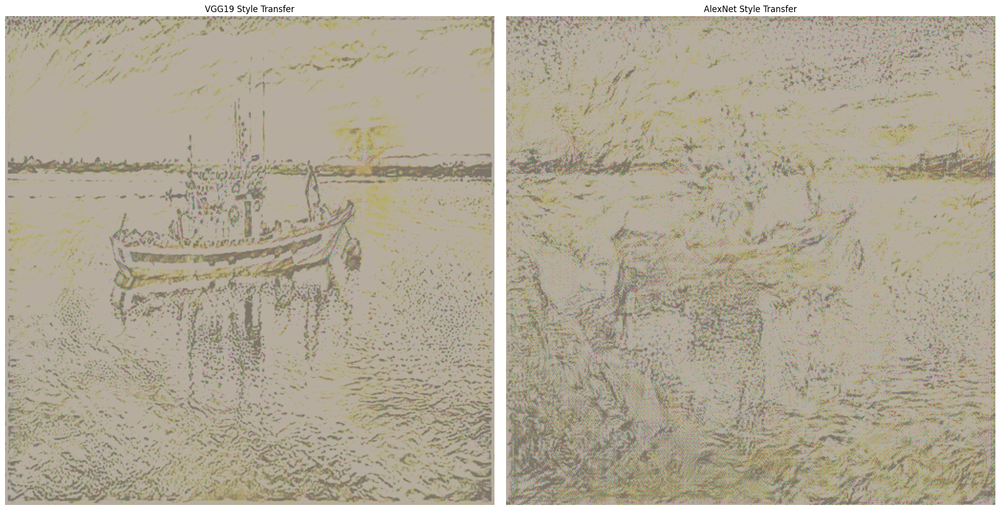


Processing Content Image 1/1: pexels-agus-66107
Style Image 4/5: vincent-van-gogh_a-fishing-boat-at-sea-1888-3(1)

Running VGG19 Style Transfer...
Performing style transfer using vgg19...


Style Transfer (vgg19):  17%|█▋        | 50/300 [01:26<07:12,  1.73s/it]

Iteration: 50
Style Loss: 1.9829
Content Loss: 37.3944
Total Loss: 39.3773
-------------------


Style Transfer (vgg19):  33%|███▎      | 100/300 [02:53<05:50,  1.75s/it]

Iteration: 100
Style Loss: 1.9420
Content Loss: 37.0193
Total Loss: 38.9613
-------------------


Style Transfer (vgg19):  50%|█████     | 150/300 [04:21<04:21,  1.74s/it]

Iteration: 150
Style Loss: 1.9370
Content Loss: 36.9618
Total Loss: 38.8988
-------------------


Style Transfer (vgg19):  67%|██████▋   | 200/300 [05:48<02:53,  1.74s/it]

Iteration: 200
Style Loss: 1.9352
Content Loss: 36.9335
Total Loss: 38.8687
-------------------


Style Transfer (vgg19):  83%|████████▎ | 250/300 [07:14<01:26,  1.73s/it]

Iteration: 250
Style Loss: 1.9334
Content Loss: 36.9180
Total Loss: 38.8514
-------------------


Style Transfer (vgg19): 100%|██████████| 300/300 [08:39<00:00,  1.73s/it]


Iteration: 300
Style Loss: 1.9329
Content Loss: 36.9077
Total Loss: 38.8405
-------------------

Running AlexNet Style Transfer...
Performing style transfer using alexnet...


Style Transfer (alexnet):  17%|█▋        | 50/300 [00:18<02:18,  1.80it/s]

Iteration: 50
Style Loss: 468.3425
Content Loss: 11.6003
Total Loss: 479.9428
-------------------


Style Transfer (alexnet):  33%|███▎      | 100/300 [00:46<01:52,  1.78it/s]

Iteration: 100
Style Loss: 7.8084
Content Loss: 8.9712
Total Loss: 16.7796
-------------------


Style Transfer (alexnet):  50%|█████     | 150/300 [01:14<01:23,  1.79it/s]

Iteration: 150
Style Loss: 3.5686
Content Loss: 8.2559
Total Loss: 11.8245
-------------------


Style Transfer (alexnet):  67%|██████▋   | 200/300 [01:42<00:55,  1.81it/s]

Iteration: 200
Style Loss: 2.8024
Content Loss: 7.9791
Total Loss: 10.7815
-------------------


Style Transfer (alexnet):  83%|████████▎ | 250/300 [02:10<00:27,  1.79it/s]

Iteration: 250
Style Loss: 2.5037
Content Loss: 7.8378
Total Loss: 10.3415
-------------------


Style Transfer (alexnet): 100%|██████████| 300/300 [02:38<00:00,  1.90it/s]


Iteration: 300
Style Loss: 2.3453
Content Loss: 7.7447
Total Loss: 10.0899
-------------------


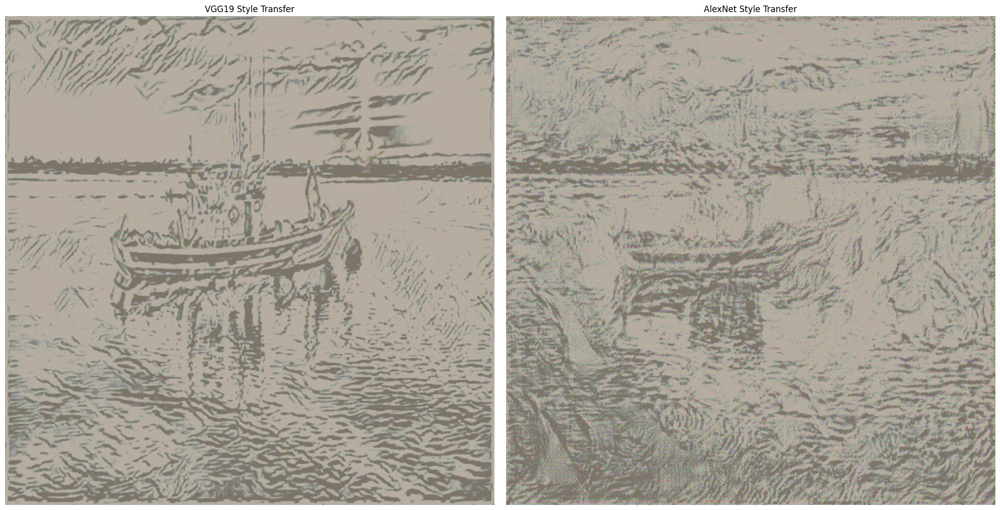


Processing Content Image 1/1: pexels-agus-66107
Style Image 5/5: vincent-van-gogh_a-group-of-cottages-1890(1)

Running VGG19 Style Transfer...
Performing style transfer using vgg19...


Style Transfer (vgg19):  17%|█▋        | 50/300 [01:26<07:08,  1.72s/it]

Iteration: 50
Style Loss: 1.6760
Content Loss: 23.4236
Total Loss: 25.0996
-------------------


Style Transfer (vgg19):  33%|███▎      | 100/300 [02:53<05:47,  1.74s/it]

Iteration: 100
Style Loss: 1.6593
Content Loss: 23.3292
Total Loss: 24.9885
-------------------


Style Transfer (vgg19):  50%|█████     | 150/300 [04:19<04:18,  1.72s/it]

Iteration: 150
Style Loss: 1.6537
Content Loss: 23.2999
Total Loss: 24.9536
-------------------


Style Transfer (vgg19):  67%|██████▋   | 200/300 [05:46<02:52,  1.72s/it]

Iteration: 200
Style Loss: 1.6514
Content Loss: 23.2855
Total Loss: 24.9369
-------------------


Style Transfer (vgg19):  83%|████████▎ | 250/300 [07:12<01:26,  1.73s/it]

Iteration: 250
Style Loss: 1.6502
Content Loss: 23.2766
Total Loss: 24.9268
-------------------


Style Transfer (vgg19): 100%|██████████| 300/300 [08:39<00:00,  1.73s/it]


Iteration: 300
Style Loss: 1.6491
Content Loss: 23.2712
Total Loss: 24.9203
-------------------

Running AlexNet Style Transfer...
Performing style transfer using alexnet...


Style Transfer (alexnet):  17%|█▋        | 50/300 [00:25<02:18,  1.80it/s]

Iteration: 50
Style Loss: 4.0647
Content Loss: 6.9622
Total Loss: 11.0269
-------------------


Style Transfer (alexnet):  33%|███▎      | 100/300 [00:52<01:51,  1.80it/s]

Iteration: 100
Style Loss: 2.6302
Content Loss: 6.3874
Total Loss: 9.0176
-------------------


Style Transfer (alexnet):  50%|█████     | 150/300 [01:20<01:23,  1.80it/s]

Iteration: 150
Style Loss: 2.3335
Content Loss: 6.2052
Total Loss: 8.5387
-------------------


Style Transfer (alexnet):  67%|██████▋   | 200/300 [01:48<00:55,  1.80it/s]

Iteration: 200
Style Loss: 2.2021
Content Loss: 6.1157
Total Loss: 8.3178
-------------------


Style Transfer (alexnet):  83%|████████▎ | 250/300 [02:16<00:27,  1.80it/s]

Iteration: 250
Style Loss: 2.1310
Content Loss: 6.0527
Total Loss: 8.1837
-------------------


Style Transfer (alexnet): 100%|██████████| 300/300 [02:44<00:00,  1.83it/s]


Iteration: 300
Style Loss: 2.0820
Content Loss: 6.0110
Total Loss: 8.0930
-------------------


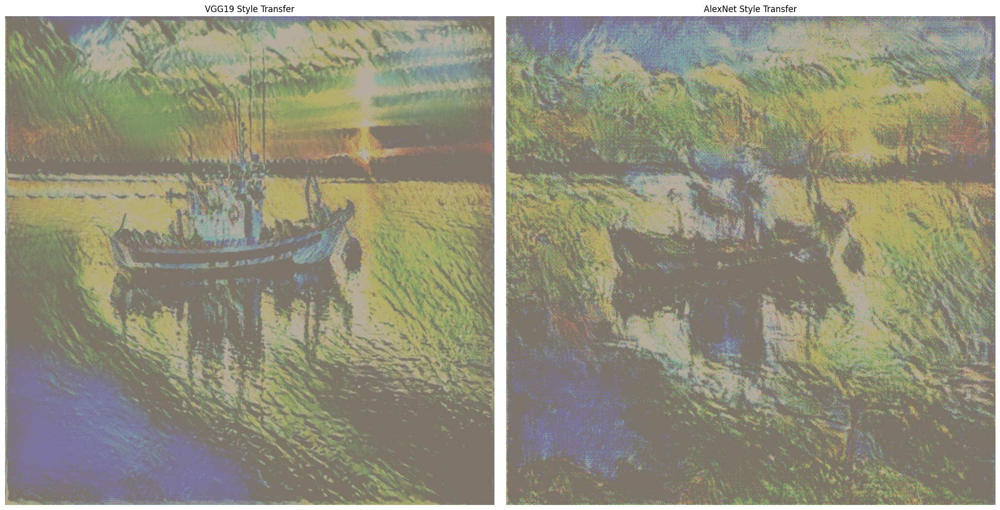

NameError: name 'FineTunedModel' is not defined

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import copy
from tqdm import tqdm

def load_image(image_path, max_size=512, shape=None):
    """Load an image and convert it to a tensor."""
    image = Image.open(image_path).convert('RGB')
    
    # Resize if needed
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
    
    loader = transforms.Compose([
        transforms.Resize((size, size)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float)

def im_convert(tensor):
    """Convert a tensor to a numpy image."""
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1, 2, 0)
    image = image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
    image = image.clip(0, 1)
    return image

class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        # Detach the target content from the tree used
        self.target = target.detach()

    def forward(self, input):
        self.loss = nn.functional.mse_loss(input, self.target)
        return input

class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = self._gram_matrix(target_feature).detach()

    def _gram_matrix(self, input):
        batch_size, n_channels, height, width = input.size()
        features = input.view(batch_size * n_channels, height * width)
        G = torch.mm(features, features.t())
        # Normalize by the total number of elements
        return G.div(batch_size * n_channels * height * width)

    def forward(self, input):
        G = self._gram_matrix(input)
        self.loss = nn.functional.mse_loss(G, self.target)
        return input

def get_model_and_losses(model_type, content_img, style_img, 
                        content_layers, style_layers, 
                        style_weights=None):
    """Initialize model and prepare model with content and style losses."""
    
    # Use equal style weights if not provided
    if style_weights is None:
        style_weights = [1.0] * len(style_layers)
    
    # Check if style_weights length matches style_layers
    if len(style_weights) != len(style_layers):
        raise ValueError(f"Style weights length ({len(style_weights)}) doesn't match style layers length ({len(style_layers)})")
    
    # Initialize the appropriate model
    if model_type.lower() == 'vgg19':
        cnn = models.vgg19(pretrained=True).features.to(device).eval()
    elif model_type.lower() == 'alexnet':
        cnn = models.alexnet(pretrained=True).features.to(device).eval()
    else:
        raise ValueError(f"Unsupported model type: {model_type}")
    
    # Create a new Sequential module to hold our model and loss modules
    model = nn.Sequential()
    
    # Lists to keep track of content and style losses
    content_losses = []
    style_losses = []
    
    # Counter to keep track of Conv layers
    conv_counter = 0
    
    i = 0  # increment every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            conv_counter += 1
            name = f'conv_{conv_counter}'
        elif isinstance(layer, nn.ReLU):
            name = f'relu_{conv_counter}'
            # Replace in-place version with out-of-place version
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = f'pool_{conv_counter}'
        elif isinstance(layer, nn.BatchNorm2d):
            name = f'bn_{conv_counter}'
        else:
            raise RuntimeError(f'Unrecognized layer: {layer.__class__.__name__}')
        
        model.add_module(name, layer)
        
        # Add content loss if we've reached a content layer
        if name in content_layers:
            # Add the content layer
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module(f"content_loss_{i}", content_loss)
            content_losses.append(content_loss)
        
        # Add style loss if we've reached a style layer
        if name in style_layers:
            # Find the index of the current style layer in the style_layers list
            style_idx = style_layers.index(name)
            
            # Add the style layer with its corresponding weight
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module(f"style_loss_{i}", style_loss)
            
            # Apply the weight to this style loss
            style_losses.append((style_loss, style_weights[style_idx]))
        
        i += 1
    
    # Trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break
    
    model = model[:(i + 1)]
    
    return model, content_losses, style_losses

def neural_style_transfer(model_type, content_img_path, style_img_path,
                          content_layer, style_layers, style_weights=None,
                          style_weight=1000000, content_weight=1,
                          num_epochs=500, show_every=100, size=512):
    content_img = load_image(content_img_path, max_size=size)
    style_img = load_image(style_img_path, max_size=size)
    input_img = content_img.clone()
    
    model, content_losses, style_losses = get_model_and_losses(
        model_type, content_img, style_img, 
        [content_layer], style_layers, 
        style_weights
    )
    
    optimizer = optim.LBFGS([input_img.requires_grad_()])
    print(f'Performing style transfer using {model_type}...')
    
    progress_bar = tqdm(total=num_epochs, desc=f"Style Transfer ({model_type})")
    
    for epoch in range(num_epochs):
        def closure():
            optimizer.zero_grad()
            model(input_img)
            style_score = 0
            content_score = 0
            
            for cl in content_losses:
                content_score += cl.loss * content_weight
            for sl, weight in style_losses:
                style_score += sl.loss * weight * style_weight
                
            loss = style_score + content_score
            loss.backward()
            return loss
        
        optimizer.step(closure)
        progress_bar.update(1)
        
        if (epoch + 1) % show_every == 0:
            with torch.no_grad():
                model(input_img)
                style_score_log = 0
                content_score_log = 0
                for cl in content_losses:
                    content_score_log += cl.loss * content_weight
                for sl, weight in style_losses:
                    style_score_log += sl.loss * weight * style_weight
                total_loss = style_score_log + content_score_log
            
            tqdm.write(f"Iteration: {epoch + 1}")
            tqdm.write(f"Style Loss: {style_score_log.item():.4f}")
            tqdm.write(f"Content Loss: {content_score_log.item():.4f}")
            tqdm.write(f"Total Loss: {total_loss.item():.4f}")
            tqdm.write("-------------------")
    
    input_img.data.clamp_(0, 1)
    progress_bar.close()    
    # Convert to numpy array for visualization
    final_img = im_convert(input_img)
    
    return final_img

def save_image(img, output_path):
    """Save the numpy array as an image."""
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
    plt.close()
    
    # Also save as PIL image for better quality
    img_pil = Image.fromarray((img * 255).astype(np.uint8))
    img_pil.save(output_path.replace('.png', '.jpg'))

# Function to display side-by-side comparison
def show_images(content_img_path, style_img_path, generated_img, title=None):
    """Display content, style, and generated images side by side."""
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    
    # Load and display content image
    content_img = Image.open(content_img_path)
    ax1.imshow(np.array(content_img))
    ax1.set_title('Content Image')
    ax1.axis('off')
    
    # Load and display style image
    style_img = Image.open(style_img_path)
    ax2.imshow(np.array(style_img))
    ax2.set_title('Style Image')
    ax2.axis('off')
    
    # Display generated image
    ax3.imshow(generated_img)
    ax3.set_title('Generated Image')
    ax3.axis('off')
    
    if title:
        fig.suptitle(title, fontsize=16)
    
    plt.tight_layout()
    plt.show()

# Function to run style transfer with both models and compare
def compare_style_transfer(content_img_path, style_img_path, output_prefix, 
                          num_epochs=300, show_every=100, size=512):
    """Run style transfer with both VGG19 and AlexNet and compare results."""
    
    # VGG19 settings
    vgg19_content_layer = 'conv_5'
    vgg19_style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']
    vgg19_style_weights = [1.0, 0.8, 0.6, 0.4, 0.2]  # Higher weight for earlier layers
    
    # AlexNet settings
    alexnet_content_layer = 'conv_5'
    alexnet_style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']
    alexnet_style_weights = [1.0, 0.8, 0.6, 0.4, 0.2]
    
    # VGG19 style transfer
    print("\nRunning VGG19 Style Transfer...")
    vgg19_img = neural_style_transfer(
        'vgg19', content_img_path, style_img_path,
        vgg19_content_layer, vgg19_style_layers, vgg19_style_weights,
        style_weight=1000000, content_weight=1,
        num_epochs=num_epochs, show_every=show_every, size=size
    )
    
    # Save VGG19 result
    vgg19_output_path = f"{output_prefix}_vgg19.png"
    save_image(vgg19_img, vgg19_output_path)
    
    # AlexNet style transfer
    print("\nRunning AlexNet Style Transfer...")
    alexnet_img = neural_style_transfer(
        'alexnet', content_img_path, style_img_path,
        alexnet_content_layer, alexnet_style_layers, alexnet_style_weights,
        style_weight=1000000, content_weight=1,
        num_epochs=num_epochs, show_every=show_every, size=size
    )
    
    # Save AlexNet result
    alexnet_output_path = f"{output_prefix}_alexnet.png"
    save_image(alexnet_img, alexnet_output_path)
    
    # Show comparison
    plt.figure(figsize=(20, 10))
    
    plt.subplot(1, 2, 1)
    plt.imshow(vgg19_img)
    plt.title('VGG19 Style Transfer')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(alexnet_img)
    plt.title('AlexNet Style Transfer')
    plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(f"{output_prefix}_comparison.png")
    plt.show()
    
    return vgg19_img, alexnet_img, vgg19_output_path, alexnet_output_path

# Main function for batch processing
def batch_style_transfer(content_img_paths, style_img_paths, output_dir, 
                        num_epochs=300, show_every=100, size=512):
    """
    Apply style transfer to multiple content images using multiple style images.
    
    Parameters:
    content_img_paths (list): List of paths to content images
    style_img_paths (list): List of paths to style images
    output_dir (str): Directory to save output images
    num_epochs (int): Number of optimization steps
    show_every (int): Frequency of displaying the generated image
    size (int): Size to resize images to
    
    Returns:
    dict: Dictionary with results information
    """
    import os
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    results = []
    
    # Process each content image with each style image
    for i, content_path in enumerate(content_img_paths):
        content_name = os.path.basename(content_path).split('.')[0]
        
        for j, style_path in enumerate(style_img_paths):
            style_name = os.path.basename(style_path).split('.')[0]
            
            print(f"\nProcessing Content Image {i+1}/{len(content_img_paths)}: {content_name}")
            print(f"Style Image {j+1}/{len(style_img_paths)}: {style_name}")
            
            output_prefix = os.path.join(output_dir, f"{content_name}_{style_name}")
            
            # Run style transfer
            vgg19_img, alexnet_img, vgg19_path, alexnet_path = compare_style_transfer(
                content_path, style_path, output_prefix,
                num_epochs=num_epochs, show_every=show_every, size=size
            )
            
            results.append({
                'content_image': content_path,
                'style_image': style_path,
                'vgg19_output': vgg19_path,
                'alexnet_output': alexnet_path
            })
    
    return results

# Function to evaluate style transfer using classification models
def evaluate_style_transfer(vgg_model, alexnet_model, output_images):
    """
    Evaluate the quality of style transfer using classification models.
    
    Parameters:
    vgg_model: Trained VGG19 classification model
    alexnet_model: Trained AlexNet classification model
    output_images: List of paths to generated images
    
    Returns:
    dict: Evaluation results
    """
    # Load and preprocess images
    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    vgg_model.eval()
    alexnet_model.eval()
    
    results = []
    
    for img_path in output_images:
        try:
            img = Image.open(img_path).convert('RGB')
            img_tensor = transform(img).unsqueeze(0).to(device)
            
            # Get predictions
            with torch.no_grad():
                vgg_output = vgg_model(img_tensor)
                alexnet_output = alexnet_model(img_tensor)
            
            vgg_prob = torch.sigmoid(vgg_output).item()
            alexnet_prob = torch.sigmoid(alexnet_output).item()
            
            img_type = 'vgg19' if 'vgg19' in img_path else 'alexnet'
            
            results.append({
                'image_path': img_path,
                'model_type': img_type,
                'vgg_prob': vgg_prob,
                'alexnet_prob': alexnet_prob,
                'is_van_gogh_vgg': vgg_prob >= 0.5,
                'is_van_gogh_alexnet': alexnet_prob >= 0.5
            })
        except Exception as e:
            print(f"Error evaluating {img_path}: {e}")
    
    return results

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Example usage:
if __name__ == "__main__":
    # Example configuration
    content_img_path = "/kaggle/input/style-transfer/"
    style_img_paths = [
    "/kaggle/input/wikiart/Post_Impressionism/vincent-van-gogh_a-field-of-yellow-flowers-1889(1).jpg",
    "/kaggle/input/wikiart/Post_Impressionism/vincent-van-gogh_a-fishing-boat-at-sea-1888(1).jpg",
    "/kaggle/input/wikiart/Post_Impressionism/vincent-van-gogh_a-fishing-boat-at-sea-1888-2(1).jpg",
    "/kaggle/input/wikiart/Post_Impressionism/vincent-van-gogh_a-fishing-boat-at-sea-1888-3(1).jpg",
    "/kaggle/input/wikiart/Post_Impressionism/vincent-van-gogh_a-group-of-cottages-1890(1).jpg"
        
    ]
    content_img_paths = [
    "/kaggle/input/style-transfer/content/pexels-agus-66107.jpg",
    ]
    
    output_dir = "style_transfer_results"
    
    # Run batch style transfer
    results = batch_style_transfer(
        content_img_paths, 
        style_img_paths, 
        output_dir,
        num_epochs=300,  # You can adjust this
        show_every=50
    )
    

In [7]:
    # Load classification models for evaluation
    vgg_model = FineTunedModel(base_model='vgg19', pretrained=True).to(device)
    vgg_model.load_state_dict(torch.load("/kaggle/working/best_model_vgg19.pth"))
    
    alexnet_model = FineTunedModel(base_model='alexnet', pretrained=True).to(device)
    alexnet_model.load_state_dict(torch.load("/kaggle/working/best_model_alexnet.pth"))
    
    # Collect all generated images
    output_images = []
    for result in results:
        output_images.append(result['vgg19_output'])
        output_images.append(result['alexnet_output'])
    
    # Evaluate style transfer
    evaluation_results = evaluate_style_transfer(vgg_model, alexnet_model, output_images)
    
    # Analyze results
    vgg_outputs = [r for r in evaluation_results if r['model_type'] == 'vgg19']
    alexnet_outputs = [r for r in evaluation_results if r['model_type'] == 'alexnet']
    
    # Calculate success rates
    vgg_success_vgg = sum(1 for r in vgg_outputs if r['is_van_gogh_vgg']) / len(vgg_outputs)
    vgg_success_alexnet = sum(1 for r in vgg_outputs if r['is_van_gogh_alexnet']) / len(vgg_outputs)
    
    alexnet_success_vgg = sum(1 for r in alexnet_outputs if r['is_van_gogh_vgg']) / len(alexnet_outputs)
    alexnet_success_alexnet = sum(1 for r in alexnet_outputs if r['is_van_gogh_alexnet']) / len(alexnet_outputs)
    
    print("\nStyle Transfer Evaluation Results:")
    print(f"VGG19-generated images classified as Van Gogh by VGG19 model: {vgg_success_vgg:.2%}")
    print(f"VGG19-generated images classified as Van Gogh by AlexNet model: {vgg_success_alexnet:.2%}")
    print(f"AlexNet-generated images classified as Van Gogh by VGG19 model: {alexnet_success_vgg:.2%}")
    print(f"AlexNet-generated images classified as Van Gogh by AlexNet model: {alexnet_success_alexnet:.2%}")

<ipython-input-7-d1ca5ea4199b>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vgg_model.load_state_dict(torch.load("/kaggle/working/best_model_vgg19.pth"))
<ipython-input-


Style Transfer Evaluation Results:
VGG19-generated images classified as Van Gogh by VGG19 model: 60.00%
VGG19-generated images classified as Van Gogh by AlexNet model: 80.00%
AlexNet-generated images classified as Van Gogh by VGG19 model: 80.00%
AlexNet-generated images classified as Van Gogh by AlexNet model: 80.00%
